#ICBHI Dataset

In [ ]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import os
from tqdm import tqdm_notebook as tqdm
from shutil import copyfile

import librosa
import librosa.display
import scipy.io.wavfile as wav

import IPython.display as ipd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# from transformers import AutoConfig, Wav2Vec2FeatureExtractor


In [ ]:
rootPath = 'drive/MyDrive/Tesi'

### Unzip dataset e divisione train/test

In [ ]:
rootPath = 'drive/MyDrive/Tesi'
!unzip -x $rootPath'/ICBHI_final_database.zip'

Archive:  drive/MyDrive/Tesi/ICBHI_final_database.zip
   creating: ICBHI_final_database/
  inflating: ICBHI_final_database/101_1b1_Al_sc_Meditron.wav  
  inflating: ICBHI_final_database/103_2b2_Ar_mc_LittC2SE.wav  
  inflating: ICBHI_final_database/104_1b1_Al_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Al_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Ar_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Ll_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Lr_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Lr_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Pl_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Pr_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Pr_sc_Litt3200.wav  
  inflating: ICBHI_final_database/105_1b1_Tc_sc_Meditron.txt  
  inflating: ICBHI_final_database/105_1b1_Tc_sc_Meditron.wav  
  inflating: ICBHI_final_database/106_2b1_Pr_mc_LittC2SE.txt  
  inflating: ICBHI_final_data

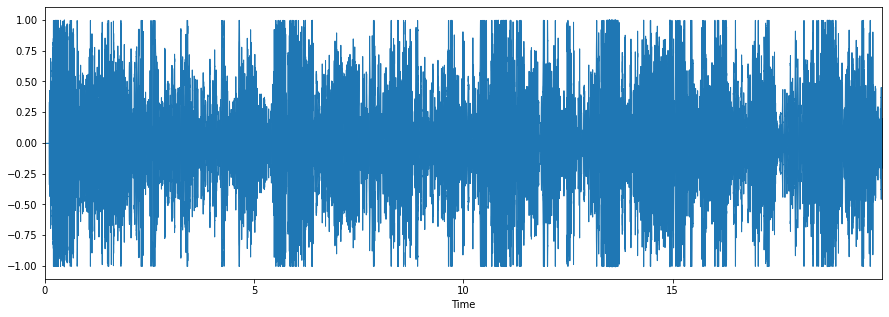

In [ ]:
import matplotlib.pyplot as plt
y, sr = librosa.load("ICBHI_final_database/107_2b3_Pl_mc_AKGC417L.wav")
plt.figure(figsize=(15,5))
librosa.display.waveplot(y, sr=sr)

In [ ]:
!ls $rootPath/'ICBHI_final_database'

In [ ]:
#c'è un errore su un file del dataset che non è stato rinominato con lo strumento di registrazione giusto

!mv $rootPath/'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.txt $rootPath/'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.txt
!mv $rootPath/'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.wav $rootPath/'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.wav

In [ ]:
import os
from shutil import copyfile
#splitting train/test
with open(os.path.join(rootPath, 'train-test_split.txt'),'r') as file:
  for line in file:
    name = line.split()[0]
    dest = line.split()[1]

    copyfile(os.path.join(rootPath,'ICBHI_final_database/'+name+'.wav'), os.path.join(rootPath, dest+'/'+name+'.wav'))
    copyfile(os.path.join(rootPath,'ICBHI_final_database/'+name+'.txt'), os.path.join(rootPath, dest+'/'+name+'.txt'))
    print(name, dest)

101_1b1_Al_sc_Meditron test
101_1b1_Pr_sc_Meditron test
102_1b1_Ar_sc_Meditron test
103_2b2_Ar_mc_LittC2SE train
104_1b1_Al_sc_Litt3200 test
104_1b1_Ar_sc_Litt3200 test
104_1b1_Ll_sc_Litt3200 test
104_1b1_Lr_sc_Litt3200 test
104_1b1_Pl_sc_Litt3200 test
104_1b1_Pr_sc_Litt3200 test
105_1b1_Tc_sc_Meditron train
106_2b1_Pl_mc_LittC2SE train
106_2b1_Pr_mc_LittC2SE train
107_2b3_Al_mc_AKGC417L train
107_2b3_Ar_mc_AKGC417L train
107_2b3_Ll_mc_AKGC417L train
107_2b3_Lr_mc_AKGC417L train
107_2b3_Pl_mc_AKGC417L train
107_2b3_Pr_mc_AKGC417L train
107_2b3_Tc_mc_AKGC417L train
107_2b4_Al_mc_AKGC417L train
107_2b4_Ar_mc_AKGC417L train
107_2b4_Ll_mc_AKGC417L train
107_2b4_Lr_mc_AKGC417L train
107_2b4_Pl_mc_AKGC417L train
107_2b4_Pr_mc_AKGC417L train
107_2b4_Tc_mc_AKGC417L train
107_2b5_Al_mc_AKGC417L train
107_2b5_Ar_mc_AKGC417L train
107_2b5_Ll_mc_AKGC417L train
107_2b5_Lr_mc_AKGC417L train
107_2b5_Pl_mc_AKGC417L train
107_2b5_Pr_mc_AKGC417L train
107_2b5_Tc_mc_AKGC417L train
107_3p2_Al_mc_AKGC417L 

### Dataframe info file audio

In [ ]:
diagnosis_df = pd.read_csv(rootPath+'/diagnosis.csv', names=['PID', 'Diagnosis'], delimiter=';')
diagnosis_df['Binary_diagnosis'] = diagnosis_df['Diagnosis'].apply(lambda x: 'Healthy' if x =='Healthy'  else 'Unhealthy')
diagnosis_df.head()

NameError: ignored

In [ ]:
diagnosis_df.info()

NameError: ignored

In [ ]:
demographic_df = pd.read_csv(rootPath+'/demographic_information.csv', names =
                 ['PID', 'Age', 'Sex' , 'Adult BMI (kg/m2)', 'Child Weight (kg)' , 'Child Height (cm)'],
                 delimiter = ';')
demographic_df.head()

In [ ]:
demographic_df.info()

https://www.kaggle.com/isurusachitha/breathcycleclassification-v3-may30

### Data Exploration
https://www.kdnuggets.com/2020/02/audio-data-analysis-deep-learning-python-part-1.html

In [ ]:
# fig, ax = plt.subplots()

# (rate,sig) = wav.read("/content/drive/MyDrive/Tesi/train/103_2b2_Ar_mc_LittC2SE.wav")
# mfcc_data = mfcc(sig,rate)


# mfcc_data= np.swapaxes(mfcc_data, 0 ,1)
# cax = ax.imshow(mfcc_data, interpolation='nearest', cmap=cm.coolwarm, origin='lower')
# ax.set_title('MFCC')

# plt.show()
path = "/content/drive/MyDrive/Tesi/train/107_2b4_Ar_mc_AKGC417L.wav"
audio, sr = librosa.load(path)
ipd.Audio(path)


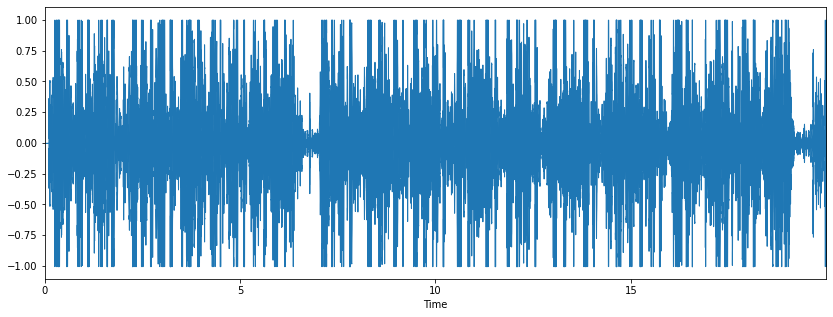

In [ ]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(audio)

#### spettrogramma
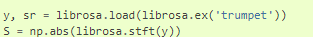

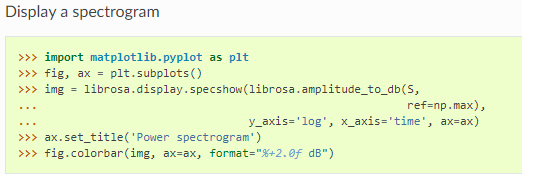

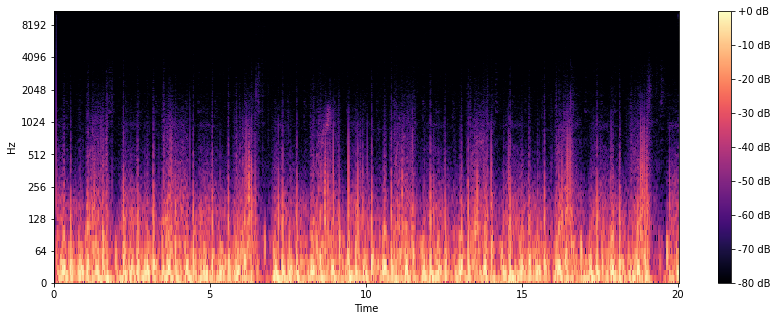

In [ ]:
#spettrogramma
X = librosa.stft(audio) #raw spectogram

#ha una parte reale e una complessa, a noi interessa solo quella reale
'''The complex part is typically not used in machine learning applications, but
there are a few papers that suggest it is useful so you may want to experiment.
For now we will discard it.
'''
X_mag, X_phase = librosa.magphase(X)
X = X_mag

Xdb = librosa.amplitude_to_db(X, ref=np.max) #spettrogramma nella scala db (decibel)
# X = Xdb

plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

#### mel-spectrogram
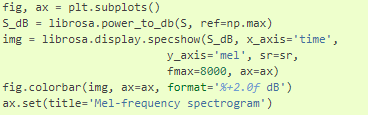

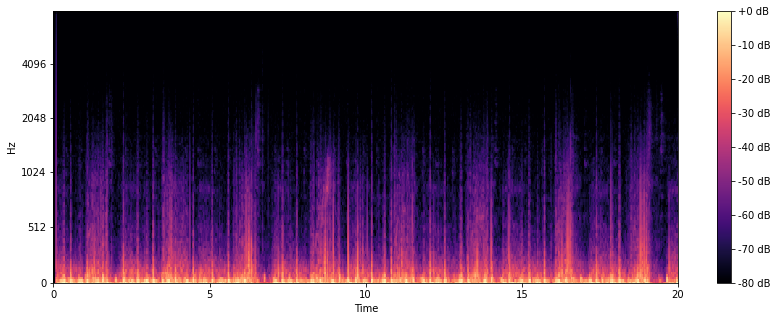

In [ ]:
#convertiamo lo spettrogramma nella scala di mel
mel = librosa.feature.melspectrogram(y=audio, sr=sr) #S è il parametro dello spettrogramma
mel_db = librosa.power_to_db(mel, ref=np.max)

plt.figure(figsize=(14, 5))
display(librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000))
plt.colorbar(format='%+2.0f dB')

### prova

In [ ]:
ipd.Audio("/content/drive/MyDrive/Tesi/train/213_2p2_Ar_mc_AKGC417L.wav")

Queste sono le annotazioni dei cicli respiratori dell'auscultazione. I cicli respiratori vanno dall'inizio dell'inspirazione alla fine dell'espirazione.

Gli indici indicano il primo la presenza/assenza di crackles, il secondo la presenza/assenza di wheezels.

In [ ]:
path = "/content/drive/MyDrive/Tesi/train/213_2p2_Ar_mc_AKGC417L.txt"
!cat $path

0.86	3.631	1	0
3.631	6.486	0	0
6.486	9.157	0	0
9.157	12.062	0	0
12.062	14.533	0	0
14.533	17.104	0	0
17.104	19.708	0	0


### Dataset ciclo respiratorio

In [ ]:
!pip install pydub

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 3021, in _dep_map
    return self.__dep_map
  File "/usr/local/lib/python3.7/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 2815, in __getattr__
    raise AttributeError(attr)
AttributeError: _DistInfoDistribution__dep_map

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/cli/base_command.py", line 180, in _main
    status = self.run(options, args)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/cli/req_command.py", line 199, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/commands/install.py", line 385, in run
    conflicts = self._determine_conflicts(to_install)
  File "/usr/local/lib/python3.7/dist-packages/pip/_internal/commands/install.py", line 515, in _det

In [ ]:
!pip install pydub

  Using cached pydub-0.25.1-py2.py3-none-any.whl (32 kB)


In [ ]:
#splitting audio file
from pydub import AudioSegment
def split_audio(filepath, t1, t2):
  t1 = t1 * 1000 #Works in milliseconds
  t2 = t2 * 1000
  newAudio = AudioSegment.from_wav(filepath)
  newAudio = newAudio[t1:t2]
  return newAudio
  # newAudio.export('newSong.wav', format="wav")

In [ ]:
#rc = Respiratory Cycle
df_rc_1 = pd.DataFrame(columns=['filename', 'crackle', 'wheeze'])
# df_rc.loc[0]=['name0'] + [0]+[1]
# df_rc = df_rc.append({'filename':'name2', 'crackle': 0, 'wheeze':1}, ignore_index=True)
df_rc_1

,filename,crackle,wheeze


In [ ]:
!rm -r '/content/drive/MyDrive/Tesi/dataset_cicli_respiratori'

In [ ]:
ipd.Audio('/content/drive/MyDrive/Tesi/dataset_cicli_respiratori/107_2b3_Ar_mc_AKGC417L_6.wav')

#### lavoriamo nella virtual machine di Colab, invece di prelevare i file da drive

In [ ]:
# n_files = !unzip -l /home/data/large_dataset.zip | grep .png | wc -l
# !unzip -o /home/data/large_dataset.zip -d /home/data/ | pv -l -s {n_files[0]} > /dev/null

In [ ]:
!unzip -x $'/content/drive/MyDrive/Tesi/ICBHI_final_database.zip'

Archive:  /content/drive/MyDrive/Tesi/ICBHI_final_database.zip
   creating: ICBHI_final_database/
  inflating: ICBHI_final_database/101_1b1_Al_sc_Meditron.wav  
  inflating: ICBHI_final_database/103_2b2_Ar_mc_LittC2SE.wav  
  inflating: ICBHI_final_database/104_1b1_Al_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Al_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Ar_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Ll_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Lr_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Lr_sc_Litt3200.wav  
  inflating: ICBHI_final_database/104_1b1_Pl_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Pr_sc_Litt3200.txt  
  inflating: ICBHI_final_database/104_1b1_Pr_sc_Litt3200.wav  
  inflating: ICBHI_final_database/105_1b1_Tc_sc_Meditron.txt  
  inflating: ICBHI_final_database/105_1b1_Tc_sc_Meditron.wav  
  inflating: ICBHI_final_database/106_2b1_Pr_mc_LittC2SE.txt  
  inflating: ICBHI_f

In [ ]:
#c'è un errore su un file del dataset che non è stato rinominato con lo strumento di registrazione giusto

!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.txt 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.txt
!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.wav 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.wav

In [ ]:
directory = r'/content/ICBHI_final_database'
filename = '157_1b1_Pr_sc_Meditron.wav'
df = pd.DataFrame(columns=['filename', 'crackle', 'wheeze'])
with open(os.path.join(directory, filename.replace('.wav','.txt')),'r') as file:
  for num_split, line in enumerate(file):
    entry = line.split('\t')
    # print(float(entry[1])-float(entry[0]))
    audio_tmp = split_audio(os.path.join(directory,filename), float(entry[0]), float(entry[1]))
    filename2 = filename.replace('.wav','_'+str(num_split))
    audio_tmp.export('/content/prova/'+filename2+'.wav', format='wav')
    df = df.append({'filename':filename2, 'crackle': entry[2], 'wheeze': entry[3].replace('\n','')}, ignore_index=True)


In [ ]:
df

In [ ]:
directory = r'/content/ICBHI_final_database'
for filename in tqdm(os.listdir(directory)):
    if filename.endswith(".wav"):# or filename.endswith(".png"):
      with open(os.path.join(directory, filename.replace('.wav','.txt')),'r') as file:
        for num_split, line in enumerate(file):
          entry = line.split('\t')
          #entry[0]=t1, entry[1]=t2, entry[2]=presence of crackles, entry[3].replace('\n','')=presence of wheezels
          audio_tmp = split_audio(os.path.join(directory,filename), float(entry[0]), float(entry[1]))
          filename2 = filename.replace('.wav','_'+str(num_split))
          audio_tmp.export('/content/dataset_cicli_respiratori/'+filename2+'.wav', format='wav')
          df_rc1 = df_rc1.append({'filename':filename2, 'crackle': entry[2], 'wheeze': entry[3].replace('\n','')}, ignore_index=True)
      # break
    else:
        continue


In [ ]:
#zippiamo la cartella per poi copiarla su drive
# !zip -r dataset_cicli_respiratori.zip dataset_cicli_respiratori/

In [ ]:
df_rc1.head()

NameError: ignored

In [ ]:
#faccio il sorting del dataframe in base al nome del file audio
df_rc_tmp = df_rc1
df_rc_tmp = df_rc_tmp.sort_values('filename',ignore_index=True)
df_rc_tmp

In [ ]:
df_rc1 = df_rc_tmp
df_rc1.to_csv(r'/content/drive/MyDrive/Tesi/dataset_rc_1.csv', index=False)
df_rc1

In [ ]:
df_rc_tmp = pd.read_csv(r'/content/drive/MyDrive/Tesi/dataset_rc1.csv')
df_rc_tmp

In [ ]:
def get_label(row):
  if row[2]==1 and row[1]==0:
    return 'wheeze'
  if row[1]==1 and row[2]==0:
    return 'crackle'
  if row[1]==1 and row[2]==1:
    return 'both'
  return 'none'

In [ ]:
df_rc_tmp['label'] = [get_label(row) for index,row in df_rc_tmp.iterrows()]
df_rc_tmp

In [ ]:
df_rc = df_rc_tmp.drop(columns=['crackle', 'wheeze'])
df_rc

In [ ]:
df_rc.to_csv(r'/content/drive/MyDrive/Tesi/dataset_rc.csv', index=False)

#### dataset cicli respiratori extended

In [ ]:
import torchaudio
import soundfile as sf

directory = r'/content/dataset_cicli_respiratori/'
for filename in tqdm(os.listdir(directory)):
    if filename.endswith(".wav"):# or filename.endswith(".png"):
      with open(os.path.join(directory, filename),'r') as file:
        # print(file.name.split('/')[-1])
        path = file.name
        speech, sr = torchaudio.load(path)
        speech = speech[0].numpy().squeeze()
        speech = librosa.resample(np.asarray(speech), sr, 16000)
        audio_tmp = np.tile(speech,3)
        sf.write('/content/dataset_cicli_respiratori_extended/' + file.name.split('/')[-1], audio_tmp, 16000)
    else:
        continue

In [ ]:
#zippiamo la cartella per poi copiarla su drive
!zip -r dataset_cicli_respiratori_extended.zip dataset_cicli_respiratori_extended/

In [ ]:
!cp dataset_cicli_respiratori_extended.zip drive/MyDrive/Tesi/

#### dataset cicli respiratori - Data Augmentation (Healthy/Unhealthy)

In [ ]:
df_rc = pd.read_csv('/content/drive/MyDrive/Tesi/dataset_rc.csv')
df_rc

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none
...,...,...
6893,226_1b1_Pl_sc_Meditron_5,crackle
6894,226_1b1_Pl_sc_Meditron_6,crackle
6895,226_1b1_Pl_sc_Meditron_7,none
6896,226_1b1_Pl_sc_Meditron_8,none


In [ ]:
df_rc.groupby('label').count()

,filename
label,
both,506
crackle,1864
none,3642
wheeze,886


In [ ]:
#extract with 7zip and progressbar to VM Colab
!7z x /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip -o/content/


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Tesi/                                      1 file, 2090629544 bytes (1994 MiB)

Extracting archive: /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip
 59% 4096 Open              --
Path = /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip
Type = zip
Physical Size = 2090629544

  0%      0% 25 - dataset_cicli_respiratori/213_1p3_Ar_mc_AKGC417L_2.wav                                                                  0% 48 - dataset_cicli_respiratori/203_2p3_Pl_mc_AKGC417L_2.wav

In [ ]:
df_binary = df_rc.copy()
# df_binary['label'] = (df_rc['label']!= ('crackle' or 'wheeze' or 'both'))*1
df_binary['label'] = (df_rc['label'] =='none')*1
df_binary['filename']="/content/dataset_cicli_respiratori/"+df_binary['filename']+'.wav'
df_binary

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6895,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6896,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1


In [ ]:
df_binary.groupby('label').count()

,filename
label,
0,3256
1,3642


In [ ]:
df_healthy = df_binary[df_binary['label']==1]
df_healthy

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
6888,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6889,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6892,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6895,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1


In [ ]:
df_unhealthy = df_binary[df_binary['label']==0]
df_unhealthy

,filename,label
36,/content/dataset_cicli_respiratori/103_2b2_Ar_...,0
38,/content/dataset_cicli_respiratori/103_2b2_Ar_...,0
39,/content/dataset_cicli_respiratori/103_2b2_Ar_...,0
40,/content/dataset_cicli_respiratori/103_2b2_Ar_...,0
48,/content/dataset_cicli_respiratori/104_1b1_Ar_...,0
...,...,...
6890,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6891,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0


In [ ]:
sr

44100

In [ ]:
path = '/content/dataset_cicli_respiratori/'+df_rc['filename'].iloc[3549]+'.wav'
audio, sr = torchaudio.load(path)
path

'/content/dataset_cicli_respiratori/162_2b4_Pl_mc_AKGC417L_3.wav'

In [ ]:
!7z x /content/drive/MyDrive/Tesi/free-sound.zip -o/content/


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Tesi/                                      1 file, 562268693 bytes (537 MiB)

Extracting archive: /content/drive/MyDrive/Tesi/free-sound.zip
--
Path = /content/drive/MyDrive/Tesi/free-sound.zip
Type = zip
Physical Size = 562268693

  0%      1% 18 - free-sound/noise-free-sound-0015.wav                                                2% 31 - free-sound/noise-free-sound-0028.wav                                                3% 35 - free-sound/noise-free-sound-0032.w

##### Background noise

In [ ]:
import math
import os
import pathlib
import random
import torch

class RandomBackgroundNoise:
    def __init__(self, sample_rate, noise_dir, min_snr_db=0, max_snr_db=15):
        self.sample_rate = sample_rate
        self.min_snr_db = min_snr_db
        self.max_snr_db = max_snr_db

        if not os.path.exists(noise_dir):
            raise IOError(f'Noise directory `{noise_dir}` does not exist')
        # find all WAV files including in sub-folders:
        self.noise_files_list = list(pathlib.Path(noise_dir).glob('**/*.wav'))
        if len(self.noise_files_list) == 0:
            raise IOError(f'No .wav file found in the noise directory `{noise_dir}`')

    def __call__(self, audio_data):
        random_noise_file = random.choice(self.noise_files_list)
        effects = [
            ['remix', '1'], # convert to mono
            ['rate', str(self.sample_rate)], # resample
        ]
        noise, _ = torchaudio.sox_effects.apply_effects_file(random_noise_file, effects, normalize=True)
        audio_length = audio_data.shape[-1]
        noise_length = noise.shape[-1]
        if noise_length > audio_length:
            offset = random.randint(0, noise_length-audio_length)
            noise = noise[..., offset:offset+audio_length]
        elif noise_length < audio_length:
            noise = torch.cat([noise, torch.zeros((noise.shape[0], audio_length-noise_length))], dim=-1)

        snr_db = random.randint(self.min_snr_db, self.max_snr_db)
        # snr_db = self.min_snr_db
        snr = math.exp(snr_db / 10)
        audio_power = audio_data.norm(p=2)
        noise_power = noise.norm(p=2)
        scale = snr * noise_power / audio_power

        return (audio_data + noise*0.1 ) / 2

noise_transform = RandomBackgroundNoise(sr, '/content/free-sound')
transformed_audio = noise_transform(audio)

In [ ]:
# add_noise(path)
# prova, _ = torchaudio.load('prova.wav')
# ipd.Audio(data=np.asarray(prova), autoplay=True, rate=16000)

In [ ]:
ipd.Audio(data=np.asarray(transformed_audio), autoplay=True, rate=sr)

In [ ]:
import IPython.display as ipd

ipd.Audio(data=np.asarray(audio), autoplay=True, rate=sr)

In [ ]:
audio.shape[1]/sr

4.278004535147392

##### Change speed

In [ ]:
import random

class SpeedChange:
    def __init__(self, sample_rate):
        self.sample_rate = sample_rate

    def __call__(self, audio_data):
        speed_factor = 0.5 if (audio_data.shape[1]/self.sample_rate)<=8 else 1.5#random.choice([0.9, 1.0, 1.1])
        # if speed_factor == 1.0: # no change
        #     return audio_data

        # change speed and resample to original rate:
        sox_effects = [
            ["speed", str(speed_factor)],
            ["rate", str(self.sample_rate)],
        ]
        transformed_audio, _ = torchaudio.sox_effects.apply_effects_tensor(
            audio_data, self.sample_rate, sox_effects)
        return transformed_audio

speed_transform = SpeedChange(sr)
transformed_audio = speed_transform(audio)

In [ ]:
torchaudio.save('/content/prova.wav', transformed_audio, sr)

In [ ]:
ipd.Audio(data=np.asarray(transformed_audio), autoplay=True, rate=sr)

In [ ]:
import IPython.display as ipd

ipd.Audio(data=np.asarray(audio), autoplay=True, rate=sr)

##### change Speed 2


In [ ]:
import random

class SpeedChange2:
    def __init__(self, sample_rate):
        self.sample_rate = sample_rate

    def __call__(self, audio_data, duration_target):
        speed_factor = (audio_data.shape[1]/self.sample_rate)/duration_target
        #0.5 if (audio_data.shape[1]/self.sample_rate)<=8 else 1.5#random.choice([0.9, 1.0, 1.1])
        # if speed_factor == 1.0: # no change
        #     return audio_data

        # change speed and resample to original rate:
        sox_effects = [
            ["speed", str(speed_factor)],
            ["rate", str(self.sample_rate)],
        ]
        transformed_audio, _ = torchaudio.sox_effects.apply_effects_tensor(
            audio_data, self.sample_rate, sox_effects)
        return transformed_audio

speed_transform = SpeedChange2(sr)
transformed_audio = speed_transform(audio, 3)

In [ ]:
torchaudio.save('/content/prova.wav', transformed_audio, sr)

In [ ]:
ipd.Audio(data=np.asarray(transformed_audio), autoplay=True, rate=sr)

In [ ]:
import IPython.display as ipd

ipd.Audio(data=np.asarray(audio), autoplay=True, rate=sr)

In [ ]:
df_rc

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none
...,...,...
6893,226_1b1_Pl_sc_Meditron_5,crackle
6894,226_1b1_Pl_sc_Meditron_6,crackle
6895,226_1b1_Pl_sc_Meditron_7,none
6896,226_1b1_Pl_sc_Meditron_8,none


In [ ]:
df_sameDuration = pd.DataFrame(columns=['filename', 'label'])
for elem,label in tqdm(zip(df_binary['filename'], df_binary['label'])):
  # elem2 = "/content/dataset_cicli_respiratori/"+elem+".wav"
  audio, sr =torchaudio.load(elem)
  speed_transform = SpeedChange2(sr)
  transformed_audio = speed_transform(audio, 3)
  path = elem.replace('.wav', '_sameDuration.wav')
  path = path.replace('dataset_cicli_respiratori', 'datasetSameDuration3sec')
  torchaudio.save(path, transformed_audio, sr)
  df_sameDuration = df_sameDuration.append({'filename':path, 'label': label}, ignore_index=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


0it [00:00, ?it/s]

In [ ]:
df_sameDuration

,filename,label
0,/content/datasetSameDuration3sec/101_1b1_Al_sc...,1
1,/content/datasetSameDuration3sec/101_1b1_Al_sc...,1
2,/content/datasetSameDuration3sec/101_1b1_Al_sc...,1
3,/content/datasetSameDuration3sec/101_1b1_Al_sc...,1
4,/content/datasetSameDuration3sec/101_1b1_Al_sc...,1
...,...,...
6893,/content/datasetSameDuration3sec/226_1b1_Pl_sc...,0
6894,/content/datasetSameDuration3sec/226_1b1_Pl_sc...,0
6895,/content/datasetSameDuration3sec/226_1b1_Pl_sc...,1
6896,/content/datasetSameDuration3sec/226_1b1_Pl_sc...,1


In [ ]:
df_sameDuration.to_csv(r'/content/drive/MyDrive/Tesi/dataset_binary_sameDuration3sec.csv', index=False)

In [ ]:
!zip -r drive/MyDrive/Tesi/datasetSameDuration3sec.zip datasetSameDuration3sec/

Output streaming troncato alle ultime 5000 righe.
  adding: datasetSameDuration3sec/135_2b3_Pr_mc_LittC2SE_8_sameDuration.wav (deflated 23%)
  adding: datasetSameDuration3sec/193_1b2_Al_mc_AKGC417L_8_sameDuration.wav (deflated 11%)
  adding: datasetSameDuration3sec/157_1b1_Lr_sc_Meditron_5_sameDuration.wav (deflated 9%)
  adding: datasetSameDuration3sec/112_1p1_Pr_sc_Litt3200_3_sameDuration.wav (deflated 11%)
  adding: datasetSameDuration3sec/178_2b2_Ar_mc_AKGC417L_9_sameDuration.wav (deflated 18%)
  adding: datasetSameDuration3sec/177_1b4_Pr_mc_AKGC417L_2_sameDuration.wav (deflated 15%)
  adding: datasetSameDuration3sec/143_1b1_Al_sc_Meditron_14_sameDuration.wav (deflated 30%)
  adding: datasetSameDuration3sec/172_1b5_Ar_mc_AKGC417L_0_sameDuration.wav (deflated 11%)
  adding: datasetSameDuration3sec/193_7b3_Pr_mc_AKGC417L_2_sameDuration.wav (deflated 15%)
  adding: datasetSameDuration3sec/130_3p2_Pl_mc_AKGC417L_6_sameDuration.wav (deflated 12%)
  adding: datasetSameDuration3sec/188_1b

##### speed+noise

In [ ]:
class ComposeTransform:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, audio_data):
        for t in self.transforms:
            audio_data = t(audio_data)
        return audio_data

compose_transform = ComposeTransform([
    SpeedChange(sr),
    RandomBackgroundNoise(sr, '/content/free-sound')])

transformed_audio = compose_transform(audio)

In [ ]:
ipd.Audio(data=np.asarray(transformed_audio), autoplay=True, rate=sr)

##### Creazione dataset Healthy/Unhealthy Augmented
Campioniamo
- 2000 sample random per aggiungere rumore (1000 healthy, 1000 unhealthy)
- 2000 sample random per modificare la velocità (1000 healthy, 1000 unhealthy)
- 2000 sample random per aggiungere rumore e modificare la velocità (1000 healthy, 1000 unhealthy)

In [ ]:
#3000 healthy
df_index_list = np.arange(df_healthy.shape[0])
random_list = random.sample(list(df_index_list), 3000)
count=0
df_healthy_augmented = pd.DataFrame(columns=['filename', 'label'])
for elem in random_list:
  audio, sr = torchaudio.load(df_healthy['filename'].iloc[elem])
  if count<1000:
    noise_transform = RandomBackgroundNoise(sr, '/content/free-sound')
    transformed_audio = noise_transform(audio)
    path = df_healthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_healthy_augmented = df_healthy_augmented.append({'filename':path, 'label': df_healthy['label'].iloc[elem]}, ignore_index=True)
  elif count>=1000 and count<2000:
    speed_transform = SpeedChange(sr)
    transformed_audio = speed_transform(audio)
    path = df_healthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_healthy_augmented = df_healthy_augmented.append({'filename':path, 'label': df_healthy['label'].iloc[elem]}, ignore_index=True)
  elif count>=2000 and count<3000:
    compose_transform = ComposeTransform([
        SpeedChange(sr),
        RandomBackgroundNoise(sr, '/content/free-sound')])

    transformed_audio = compose_transform(audio)
    path = df_healthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_healthy_augmented = df_healthy_augmented.append({'filename':path, 'label': df_healthy['label'].iloc[elem]}, ignore_index=True)
  count = count+1

In [ ]:
#3000 unhealthy
df_index_list = np.arange(df_unhealthy.shape[0])
random_list = random.sample(list(df_index_list), 3000)
count=0
df_unhealthy_augmented = pd.DataFrame(columns=['filename', 'label'])
for elem in random_list:
  audio, sr = torchaudio.load(df_unhealthy['filename'].iloc[elem])
  if count<1000:
    noise_transform = RandomBackgroundNoise(sr, '/content/free-sound')
    transformed_audio = noise_transform(audio)
    path = df_unhealthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_unhealthy_augmented = df_unhealthy_augmented.append({'filename':path, 'label': df_unhealthy['label'].iloc[elem]}, ignore_index=True)
  elif count>=1000 and count<2000:
    speed_transform = SpeedChange(sr)
    transformed_audio = speed_transform(audio)
    path = df_unhealthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_unhealthy_augmented = df_unhealthy_augmented.append({'filename':path, 'label': df_unhealthy['label'].iloc[elem]}, ignore_index=True)
  elif count>=2000 and count<3000:
    compose_transform = ComposeTransform([
        SpeedChange(sr),
        RandomBackgroundNoise(sr, '/content/free-sound')])

    transformed_audio = compose_transform(audio)
    path = df_unhealthy['filename'].iloc[elem].replace('.wav', '_augmented.wav')
    path = path.replace('dataset_cicli_respiratori', 'augmented_sample')
    torchaudio.save(path, transformed_audio, sr)
    df_unhealthy_augmented = df_unhealthy_augmented.append({'filename':path, 'label': df_unhealthy['label'].iloc[elem]}, ignore_index=True)
  count = count+1

In [ ]:
df_healthy_augmented

,filename,label
0,/content/augmented_sample/195_1b1_Pr_sc_Litt32...,1
1,/content/augmented_sample/207_2b3_Pr_mc_AKGC41...,1
2,/content/augmented_sample/133_2p4_Tc_mc_AKGC41...,1
3,/content/augmented_sample/203_1p3_Pr_mc_AKGC41...,1
4,/content/augmented_sample/170_2b2_Pr_mc_AKGC41...,1
...,...,...
2995,/content/augmented_sample/193_1b2_Tc_mc_AKGC41...,1
2996,/content/augmented_sample/200_2p4_Pl_mc_AKGC41...,1
2997,/content/augmented_sample/157_1b1_Ar_sc_Meditr...,1
2998,/content/augmented_sample/151_2p3_Pr_mc_AKGC41...,1


In [ ]:
df_unhealthy_augmented

,filename,label
0,/content/augmented_sample/130_3p3_Pr_mc_AKGC41...,0
1,/content/augmented_sample/201_1b1_Al_sc_Meditr...,0
2,/content/augmented_sample/213_1p2_Pr_mc_AKGC41...,0
3,/content/augmented_sample/145_2b2_Ar_mc_AKGC41...,0
4,/content/augmented_sample/179_1b1_Tc_sc_Meditr...,0
...,...,...
2995,/content/augmented_sample/206_1b1_Pl_sc_Meditr...,0
2996,/content/augmented_sample/172_1b3_Ll_mc_AKGC41...,0
2997,/content/augmented_sample/147_1b2_Tc_mc_AKGC41...,0
2998,/content/augmented_sample/130_3p4_Al_mc_AKGC41...,0


In [ ]:
df_binary

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6895,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6896,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1


In [ ]:
!zip -r drive/MyDrive/Tesi/augmented_sample.zip augmented_sample/

Output streaming troncato alle ultime 5000 righe.
  adding: augmented_sample/172_1b3_Pl_mc_AKGC417L_5_augmented.wav (deflated 13%)
  adding: augmented_sample/222_1b1_Pr_sc_Meditron_8_augmented.wav (deflated 10%)
  adding: augmented_sample/147_1b2_Tc_mc_AKGC417L_10_augmented.wav (deflated 12%)
  adding: augmented_sample/130_3b4_Pr_mc_AKGC417L_3_augmented.wav (deflated 18%)
  adding: augmented_sample/146_8p3_Lr_mc_AKGC417L_6_augmented.wav (deflated 19%)
  adding: augmented_sample/160_2b4_Tc_mc_AKGC417L_1_augmented.wav (deflated 12%)
  adding: augmented_sample/172_2b5_Ar_mc_AKGC417L_2_augmented.wav (deflated 13%)
  adding: augmented_sample/223_1b1_Pr_sc_Meditron_1_augmented.wav (deflated 13%)
  adding: augmented_sample/134_2b3_Ar_mc_LittC2SE_5_augmented.wav (deflated 15%)
  adding: augmented_sample/178_2b2_Ar_mc_AKGC417L_5_augmented.wav (deflated 19%)
  adding: augmented_sample/207_3b2_Lr_mc_AKGC417L_3_augmented.wav (deflated 13%)
  adding: augmented_sample/107_3p2_Tc_mc_AKGC417L_8_augmen

In [ ]:
random_list = random.sample(list(df_index_list), 6000)

In [ ]:
df_binary_augmented = pd.concat([df_binary, df_healthy_augmented, df_unhealthy_augmented], ignore_index=True)
df_binary_augmented

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
12893,/content/augmented_sample/206_1b1_Pl_sc_Meditr...,0
12894,/content/augmented_sample/172_1b3_Ll_mc_AKGC41...,0
12895,/content/augmented_sample/147_1b2_Tc_mc_AKGC41...,0
12896,/content/augmented_sample/130_3p4_Al_mc_AKGC41...,0


In [ ]:
df_binary_augmented.to_csv(r'/content/drive/MyDrive/Tesi/dataset_binary_augmented.csv', index=False)

####dataset cicli respiratori healthy/unhealthy reduced

In [ ]:
df_rc = pd.read_csv('/content/drive/MyDrive/Tesi/dataset_rc.csv')
df_rc

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none
...,...,...
6893,226_1b1_Pl_sc_Meditron_5,crackle
6894,226_1b1_Pl_sc_Meditron_6,crackle
6895,226_1b1_Pl_sc_Meditron_7,none
6896,226_1b1_Pl_sc_Meditron_8,none


In [ ]:
df_binary = df_rc.copy()
# df_binary['label'] = (df_rc['label']!= ('crackle' or 'wheeze' or 'both'))*1
df_binary['label'] = (df_rc['label'] =='none')*1
df_binary['filename']="/content/dataset_cicli_respiratori/"+df_binary['filename']+'.wav'
df_binary

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6895,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1
6896,/content/dataset_cicli_respiratori/226_1b1_Pl_...,1


In [ ]:
df_binary.groupby('label').count()

,filename
label,
0,3256
1,3642


In [ ]:
df_binary = df_binary.drop(df_binary[df_binary['label'] == 1].sample(frac=.6).index)
df_binary

,filename,label
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
8,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
10,/content/dataset_cicli_respiratori/101_1b1_Al_...,1
...,...,...
6890,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6891,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,0


In [ ]:
df_binary.groupby('label').count()

,filename
label,
0,1864
1,2014


In [ ]:
df_binary.to_csv(r'/content/drive/MyDrive/Tesi/dataset_rc_healthy-unhealthy_balanced.csv', index=False)

#### unzip dataset respiratory cycle nell VM colab

In [ ]:
df_rc = pd.read_csv('/content/drive/MyDrive/Tesi/dataset_rc.csv')

In [ ]:
#unzip dataset ichbi per test sui file audio
!7z x /content/drive/MyDrive/Tesi/ICBHI_final_database.zip -o/content/

In [ ]:
#c'è un errore su un file del dataset che non è stato rinominato con lo strumento di registrazione giusto

!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.txt 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.txt
!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.wav 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.wav

In [ ]:
#extract with 7zip and progressbar to VM Colab
!7z x /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip -o/content/

In [ ]:
#extract with 7zip and progressbar to VM Colab
!7z x /content/drive/MyDrive/Tesi/dataset_cicli_respiratori_extended.zip -o/content/


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.00GHz (50653),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Tesi/                                      1 file, 1561555836 bytes (1490 MiB)

Extracting archive: /content/drive/MyDrive/Tesi/dataset_cicli_respiratori_extended.zip
 59% 4096 Open              --
Path = /content/drive/MyDrive/Tesi/dataset_cicli_respiratori_extended.zip
Type = zip
Physical Size = 1561555836

  0%      0% 56 - dataset_cicli_respiratori_extended/170_1b3_Ar_mc_AKGC417L_4.wav                                                                           1% 105 - da

In [ ]:
audio, sr = librosa.load('/content/dataset_cicli_respiratori/226_1b1_Pl_sc_Meditron_6.wav')
#convertiamo lo spettrogramma nella scala di mel
mel = librosa.feature.melspectrogram(y=audio, sr=sr) #S è il parametro dello spettrogramma
mel_db = librosa.power_to_db(mel, ref=np.max)

# plt.figure(figsize=(14, 5))
# display(librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000))
# plt.colorbar(format='%+2.0f dB')
librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000)
plt.colorbar(format='%+2.0f dB')

In [ ]:
# plt.figure()

def mel_db_plot(path):
  audio, sr = librosa.load(path)
  #convertiamo lo spettrogramma nella scala di mel
  mel = librosa.feature.melspectrogram(y=audio, sr=sr) #S è il parametro dello spettrogramma
  mel_db = librosa.power_to_db(mel, ref=np.max)

  # plt.subplot(221)
  librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000)
  plt.colorbar(format='%+2.0f dB')
# plt.grid(True)

In [ ]:
audio, sr = librosa.load('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_1.wav')
#convertiamo lo spettrogramma nella scala di mel
mel = librosa.feature.melspectrogram(y=audio, sr=sr) #S è il parametro dello spettrogramma
mel_db = librosa.power_to_db(mel, ref=np.max)
display(librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000))
plt.colorbar(format='%+2.0f dB')
print('---------------------------')
print(sr)


In [ ]:
plt.figure(figsize=(20, 10))

plt.subplot(231)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_1.wav')
plt.title('1')

plt.subplot(232)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_2.wav')
plt.title('2')

plt.subplot(233)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_3.wav')
plt.title('3')

plt.subplot(234)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_4.wav')
plt.title('4')

plt.subplot(235)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_5.wav')
plt.title('5')

plt.subplot(236)
mel_db_plot('/content/dataset_cicli_respiratori/211_1p2_Pl_mc_AKGC417L_6.wav')
plt.title('6')

plt.show()

In [ ]:
ipd.Audio('/content/ICBHI_final_database/211_1p2_Pl_mc_AKGC417L.wav')

#### prova riduzione rumore

In [ ]:
# import noisereduce as nr
# audio, sr = librosa.load('/content/ICBHI_final_database/211_1p2_Pl_mc_AKGC417L.wav')
# noisy_part = audio[:]
# reduced_noise = nr.reduce_noise(use_tensorflow=True, n_fft=2048, n_grad_freq=1, n_grad_time=2, audio_clip=audio, noise_clip=noisy_part, verbose=True)

In [ ]:
# ipd.Audio(data=reduced_noise, rate=sr)

In [ ]:
from scipy.io import wavfile
from scipy import signal
audio, sr = librosa.load('/content/ICBHI_final_database/211_1p2_Pl_mc_AKGC417L.wav')
b = signal.firwin(200, cutoff=250, fs=sr, pass_zero='lowpass')
# b = signal.butter(40, 50, analog=False, fs=sr)

x = signal.lfilter(b, [1.0], audio)

wavfile.write('test2.wav', sr, x.astype(np.int16))

In [ ]:
ipd.Audio(data=x, rate=sr)

In [ ]:
plt.figure(figsize=(20,5))
plt.subplot(121)
mel_db_plot('/content/ICBHI_final_database/211_1p2_Pl_mc_AKGC417L.wav')

plt.subplot(122)
mel_db_plot('test2.wav')

plt.show()

In [ ]:
plt.figure(figsize=(20,5))
plt.subplot(121)
mel_db_plot('/content/ICBHI_final_database/211_1p2_Pl_mc_AKGC417L.wav')

plt.subplot(122)
mel_db_plot('test2.wav')

plt.show()

In [ ]:
ipd.Audio('/content/ICBHI_final_database/210_1b1_Al_sc_Meditron.wav')

In [ ]:
from scipy.io import wavfile
from scipy import signal

#test filtro passa-basso su file senza rumore
audio, sr = librosa.load('/content/ICBHI_final_database/210_1b1_Al_sc_Meditron.wav')
b = signal.firwin(200, cutoff=250, fs=sr, pass_zero='lowpass')
# b = signal.butter(40, 50, analog=False, fs=sr)

x = signal.lfilter(b, [1.0], audio)

wavfile.write('test3.wav', sr,x)


In [ ]:
ipd.Audio(data=x, rate=sr)

In [ ]:
plt.figure(figsize=(20,5))
plt.subplot(121)
mel_db_plot('/content/ICBHI_final_database/210_1b1_Al_sc_Meditron.wav')

plt.subplot(122)
mel_db_plot('test3.wav')

plt.show()

###prova Wav2vec2 4-label classification

In [ ]:
!pip install transformers

In [ ]:
from transformers import AutoTokenizer, Wav2Vec2ForCTC

tokenizer = AutoTokenizer.from_pretrained("facebook/wav2vec2-base-960h")

model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

Downloading:   0%|          | 0.00/163 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.60k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/291 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/85.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/378M [00:00<?, ?B/s]

Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
from transformers import Wav2Vec2Model, Wav2Vec2Config

# Initializing a Wav2Vec2 facebook/wav2vec2-base-960h style configuration
configuration = Wav2Vec2Config()

# Initializing a model from the facebook/wav2vec2-base-960h style configuration
model = Wav2Vec2Model(configuration)

# Accessing the model configuration
configuration = model.config

#### data exploration

In [ ]:
tmp = df_rc
tmp['filename'] = ['/content/dataset_cicli_respiratori_extended/'+filename+'.wav' for filename in tmp['filename']]
tmp
df_rc = tmp

In [ ]:
df_rc

,filename,label
0,/content/dataset_cicli_respiratori_extended/10...,none
1,/content/dataset_cicli_respiratori_extended/10...,none
2,/content/dataset_cicli_respiratori_extended/10...,none
3,/content/dataset_cicli_respiratori_extended/10...,none
4,/content/dataset_cicli_respiratori_extended/10...,none
...,...,...
6893,/content/dataset_cicli_respiratori_extended/22...,crackle
6894,/content/dataset_cicli_respiratori_extended/22...,crackle
6895,/content/dataset_cicli_respiratori_extended/22...,none
6896,/content/dataset_cicli_respiratori_extended/22...,none


In [ ]:
#distribuzione label dataset
print('Labels: ', df_rc['label'].unique())
df_rc.groupby('label').count()

Labels:  ['none' 'wheeze' 'crackle' 'both']


,filename
label,
both,506
crackle,1864
none,3642
wheeze,886


In [ ]:
import torchaudio
import librosa
import IPython.display as ipd
import numpy as np

idx = 3081#np.random.randint(0, len(df_rc))
sample = df_rc.iloc[idx]
path = sample["filename"]
label = sample["label"]
print(path)

print(f"ID Location: {idx}")
print(f"      Label: {label}")
print()

speech, sr = torchaudio.load(path)
speech = speech[0].numpy().squeeze()
speech = librosa.resample(np.asarray(speech), sr, 16000)
ipd.Audio(data=np.asarray(speech), autoplay=True, rate=16000)

/content/dataset_cicli_respiratori_extended/157_1b1_Pr_sc_Meditron_14.wav
ID Location: 3081
      Label: crackle



In [ ]:
arr = [1,2,3]
arr2 = np.tile(arr,2)
print(arr2)

[1 2 3 1 2 3]


In [ ]:
# import numpy as np
# tmp = np.tile(speech, 3)
# ipd.Audio(data=np.asarray(tmp), autoplay=True, rate=16000)

Dividiamo il dataset in train set e test set. Proviamo a riservare il 20% del dataset per il test set

In [ ]:
save_path = '/content/drive/MyDrive/Tesi/respiratory_cicle_extended'
train_df, test_df = train_test_split(df_rc, test_size=0.2, random_state=42, stratify=df_rc["label"])

train_df = train_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

train_df.to_csv(f"{save_path}/train_rc.csv", sep="\t", encoding="utf-8", index=False)
test_df.to_csv(f"{save_path}/test_rc.csv", sep="\t", encoding="utf-8", index=False)


print(train_df.shape)
print(test_df.shape)

(5518, 2)
(1380, 2)


In [ ]:
# Loading the created dataset using datasets
from datasets import load_dataset, load_metric

save_path = '/content/drive/MyDrive/Tesi/respiratory_cicle_extended'

data_files = {
    "train": save_path+"/train_rc.csv",
    "validation": save_path+"/test_rc.csv",
}

dataset = load_dataset("csv", data_files=data_files, delimiter="\t", )
train_dataset = dataset["train"]
eval_dataset = dataset["validation"]

print(train_dataset)
print(eval_dataset)

Using custom data configuration default-c2092be64ed5e367


0 tables [00:00, ? tables/s]

0 tables [00:00, ? tables/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-c2092be64ed5e367/0.0.0/9144e0a4e8435090117cea53e6c7537173ef2304525df4a077c435d8ee7828ff. Subsequent calls will reuse this data.
Dataset({
    features: ['filename', 'label'],
    num_rows: 5518
})
Dataset({
    features: ['filename', 'label'],
    num_rows: 1380
})


In [ ]:
# estraiamo la lista delle etichette
input_column = "filename"
output_column = "label"

label_list = train_dataset.unique(output_column)
label_list.sort()  # Let's sort it for determinism
num_labels = len(label_list)
print(f"A classification problem with {num_labels} classes: {label_list}")

A classification problem with 4 classes: ['both', 'crackle', 'none', 'wheeze']


In order to preprocess the audio into our classification model, we need to set up the relevant Wav2Vec2 assets regarding our language in this case lighteternal/wav2vec2-large-xlsr-53-greek fine-tuned by Dimitris Papadopoulos. To handle the context representations in any audio length we use a merge strategy plan (pooling mode) to concatenate that 3D representations into 2D representations.

There are three merge strategies mean, sum, and max. In this example, we achieved better results on the mean approach. In the following, we need to initiate the config and the feature extractor from the Dimitris model.

In [ ]:
#provo questo
# model_name = 'facebook/wav2vec2-base-100k-voxpopuli'
model_name_or_path = "facebook/wav2vec2-base-960h"
pooling_mode = "mean"

In [ ]:
# config
config = AutoConfig.from_pretrained(
    model_name_or_path,
    num_labels=num_labels,
    label2id={label: i for i, label in enumerate(label_list)},
    id2label={i: label for i, label in enumerate(label_list)},
    finetuning_task="wav2vec2_clf",
)
setattr(config, 'pooling_mode', pooling_mode)

In [ ]:
feature_extractor = Wav2Vec2FeatureExtractor.from_pretrained(model_name_or_path)
target_sampling_rate = feature_extractor.sampling_rate
print(f"The target sampling rate: {target_sampling_rate}")

Downloading:   0%|          | 0.00/159 [00:00<?, ?B/s]

The target sampling rate: 16000


An audio file usually stores both its values and the sampling rate with which the speech signal was digitalized. We want to store both in the dataset and write a map(...) function accordingly. Also, we need to handle the string labels into integers for our specific classification task in this case, the single-label classification you may want to use for your regression or even multi-label classification.

In [ ]:
import torchaudio.transforms as T
def speech_file_to_array_fn(path):
    speech_array, sampling_rate = torchaudio.load(path)
    resampler = torchaudio.transforms.Resample(sampling_rate, target_sampling_rate)
    speech = resampler(speech_array).squeeze().numpy()

    # print(speech_array)
    # mfcc = T.MFCC()(speech_array)
    #convertiamo lo spettrogramma nella scala di mel
    # mel = librosa.feature.melspectrogram(y=speech, sr=target_sampling_rate) #S è il parametro dello spettrogramma
    # mel_db = librosa.power_to_db(mel, ref=np.max)

    # plt.figure(figsize=(14, 5))
    # display(librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel', fmax=8000))
    # plt.colorbar(format='%+2.0f dB')
    # print(speech)
    return speech
def label_to_id(label, label_list):

    if len(label_list) > 0:
        return label_list.index(label) if label in label_list else -1

    return label

def preprocess_function(examples):
    speech_list = [speech_file_to_array_fn(path) for path in examples[input_column]]
    target_list = [label_to_id(label, label_list) for label in examples[output_column]]

    result = feature_extractor(speech_list, sampling_rate=target_sampling_rate, padding=True)
    result["labels"] = list(target_list)

    return result

In [ ]:
train_dataset = train_dataset.map(
    preprocess_function,
    batch_size=100,
    batched=True,
    num_proc=4
)
eval_dataset = eval_dataset.map(
    preprocess_function,
    batch_size=100,
    batched=True,
    num_proc=4
)

In [ ]:
print(eval_dataset)

In [ ]:
#un esempio
idx = 544
print(f"Training input_values: {train_dataset[idx]['input_values']}")
# print(f"Training attention_mask: {train_dataset[idx]['attention_mask']}")
print(f"Training labels: {train_dataset[idx]['labels']} - {train_dataset[idx]['label']}")

merge strategy sarebbe il pooling per utilizzare file audio di ogni length

#### Creazione modello

In [ ]:
from dataclasses import dataclass
from typing import Optional, Tuple
import torch
from transformers.file_utils import ModelOutput

#classe con i dati di interesse
@dataclass
class AuscultationClassifierOutput(ModelOutput):
    loss: Optional[torch.FloatTensor] = None
    logits: torch.FloatTensor = None
    hidden_states: Optional[Tuple[torch.FloatTensor]] = None
    attentions: Optional[Tuple[torch.FloatTensor]] = None


In [ ]:
#modello
import torch
import torch.nn as nn
from torch.nn import BCEWithLogitsLoss, CrossEntropyLoss, MSELoss

from transformers.models.wav2vec2.modeling_wav2vec2 import (
    Wav2Vec2PreTrainedModel,
    Wav2Vec2Model
)


class Wav2Vec2ClassificationHead(nn.Module):
    """Head for wav2vec classification task."""

    def __init__(self, config):
        super().__init__()
        self.dense = nn.Linear(config.hidden_size, config.hidden_size)

        self.dropout = nn.Dropout(config.final_dropout)
        self.out_proj = nn.Linear(config.hidden_size, config.num_labels)

    def forward(self, features, **kwargs):
        x = features
        x = self.dropout(x)
        x = self.dense(x)
        x = torch.tanh(x)
        x = self.dropout(x)
        x = self.out_proj(x)
        return x


class Wav2Vec2ForAuscultationClassification(Wav2Vec2PreTrainedModel):
    def __init__(self, config):
        super().__init__(config)
        self.num_labels = config.num_labels
        self.pooling_mode = config.pooling_mode
        self.config = config

        self.wav2vec2 = Wav2Vec2Model(config)
        self.classifier = Wav2Vec2ClassificationHead(config)

        self.init_weights()

    def freeze_feature_extractor(self):
        self.wav2vec2.feature_extractor._freeze_parameters()

    def merged_strategy(
            self,
            hidden_states,
            mode="mean"
    ):
        if mode == "mean":
            outputs = torch.mean(hidden_states, dim=1)
        elif mode == "sum":
            outputs = torch.sum(hidden_states, dim=1)
        elif mode == "max":
            outputs = torch.max(hidden_states, dim=1)[0]
        else:
            raise Exception(
                "The pooling method hasn't been defined! Your pooling mode must be one of these ['mean', 'sum', 'max']")

        return outputs

    def forward(
            self,
            input_values,
            attention_mask=None,
            output_attentions=None,
            output_hidden_states=None,
            return_dict=None,
            labels=None,
    ):

        return_dict = return_dict if return_dict is not None else self.config.use_return_dict
        outputs = self.wav2vec2(
            input_values,
            attention_mask=attention_mask,
            output_attentions=output_attentions,
            output_hidden_states=output_hidden_states,
            return_dict=return_dict,
        )
        hidden_states = outputs[0]
        hidden_states = self.merged_strategy(hidden_states, mode=self.pooling_mode)
        logits = self.classifier(hidden_states)

        loss = None
        if labels is not None:
            if self.config.problem_type is None:
                if self.num_labels == 1:
                    self.config.problem_type = "regression"
                elif self.num_labels > 1 and (labels.dtype == torch.long or labels.dtype == torch.int):
                    self.config.problem_type = "single_label_classification"
                else:
                    self.config.problem_type = "multi_label_classification"

            if self.config.problem_type == "regression":
                loss_fct = MSELoss()
                loss = loss_fct(logits.view(-1, self.num_labels), labels)
            elif self.config.problem_type == "single_label_classification":
                loss_fct = CrossEntropyLoss()
                loss = loss_fct(logits.view(-1, self.num_labels), labels.view(-1))
            elif self.config.problem_type == "multi_label_classification":
                loss_fct = BCEWithLogitsLoss()
                loss = loss_fct(logits, labels)

        if not return_dict:
            output = (logits,) + outputs[2:]
            return ((loss,) + output) if loss is not None else output

        return AuscultationClassifierOutput(
            loss=loss,
            logits=logits,
            hidden_states=outputs.hidden_states,
            attentions=outputs.attentions,
        )


#### Training
The data is processed so that we are ready to start setting up the training pipeline. We will make use of 🤗's Trainer for which we essentially need to do the following:

Define a data collator. In contrast to most NLP models, XLSR-Wav2Vec2 has a much larger input length than output length. E.g., a sample of input length 50000 has an output length of no more than 100. Given the large input sizes, it is much more efficient to pad the training batches dynamically meaning that all training samples should only be padded to the longest sample in their batch and not the overall longest sample. Therefore, fine-tuning XLSR-Wav2Vec2 requires a special padding data collator, which we will define below

Evaluation metric. During training, the model should be evaluated on the word error rate. We should define a compute_metrics function accordingly

Load a pretrained checkpoint. We need to load a pretrained checkpoint and configure it correctly for training.

Define the training configuration.

After having fine-tuned the model, we will correctly evaluate it on the test data and verify that it has indeed learned to correctly transcribe speech.
__________________

Let's start by defining the data collator. The code for the data collator was copied from an example from HuggingFace.

Without going into too many details, in contrast to the common data collators, this data collator treats the input_values and labels differently and thus applies to separate padding functions on them (again making use of XLSR-Wav2Vec2's context manager). This is necessary because in speech input and output are of different modalities meaning that they should not be treated by the same padding function. Analogous to the common data collators, the padding tokens in the labels with -100 so that those tokens are not taken into account when computing the loss.

In [ ]:
from dataclasses import dataclass
from typing import Dict, List, Optional, Union
import torch

import transformers
from transformers import Wav2Vec2FeatureExtractor #Wav2Vec2Processor,


@dataclass
class DataCollatorCTCWithPadding:
    """
    Data collator that will dynamically pad the inputs received.
    Args:
        feature_extractor (:class:`~transformers.Wav2Vec2FeatureExtractor`)
            The feature_extractor used for proccessing the data.
        padding (:obj:`bool`, :obj:`str` or :class:`~transformers.tokenization_utils_base.PaddingStrategy`, `optional`, defaults to :obj:`True`):
            Select a strategy to pad the returned sequences (according to the model's padding side and padding index)
            among:
            * :obj:`True` or :obj:`'longest'`: Pad to the longest sequence in the batch (or no padding if only a single
              sequence if provided).
            * :obj:`'max_length'`: Pad to a maximum length specified with the argument :obj:`max_length` or to the
              maximum acceptable input length for the model if that argument is not provided.
            * :obj:`False` or :obj:`'do_not_pad'` (default): No padding (i.e., can output a batch with sequences of
              different lengths).
        max_length (:obj:`int`, `optional`):
            Maximum length of the ``input_values`` of the returned list and optionally padding length (see above).
        max_length_labels (:obj:`int`, `optional`):
            Maximum length of the ``labels`` returned list and optionally padding length (see above).
        pad_to_multiple_of (:obj:`int`, `optional`):
            If set will pad the sequence to a multiple of the provided value.
            This is especially useful to enable the use of Tensor Cores on NVIDIA hardware with compute capability >=
            7.5 (Volta).
    """

    feature_extractor: Wav2Vec2FeatureExtractor
    padding: Union[bool, str] = True
    max_length: Optional[int] = None
    max_length_labels: Optional[int] = None
    pad_to_multiple_of: Optional[int] = None
    pad_to_multiple_of_labels: Optional[int] = None

    def __call__(self, features: List[Dict[str, Union[List[int], torch.Tensor]]]) -> Dict[str, torch.Tensor]:
        input_features = [{"input_values": feature["input_values"]} for feature in features]
        label_features = [feature["labels"] for feature in features]


        d_type = torch.long if isinstance(label_features[0], int) else torch.float

        batch = self.feature_extractor.pad(
            input_features,
            padding=self.padding,
            max_length=self.max_length,
            pad_to_multiple_of=self.pad_to_multiple_of,
            return_tensors="pt",
        )

        batch["labels"] = torch.tensor(label_features, dtype=d_type)

        return batch


In [ ]:
data_collator = DataCollatorCTCWithPadding(feature_extractor=feature_extractor, padding=True)

Next, the evaluation metric is defined. There are many pre-defined metrics for classification/regression problems, but in this case, we would continue with just Accuracy for classification and MSE for regression. You can define other metrics on your own.


In [ ]:
is_regression=False

In [ ]:
import numpy as np
from transformers import EvalPrediction


def compute_metrics(p: EvalPrediction):
    preds = p.predictions[0] if isinstance(p.predictions, tuple) else p.predictions
    preds = np.squeeze(preds) if is_regression else np.argmax(preds, axis=1)
    # print("ANTO")
    # print(p.label_ids)
    # print(preds)
    # print(preds == p.label_ids)
    # print("ANTO")
    if is_regression:
        return {"mse": ((preds - p.label_ids) ** 2).mean().item()}
    else:
        return {"accuracy": (preds == p.label_ids).astype(np.float32).mean().item()}

Now, we can load the pretrained XLSR-Wav2Vec2 checkpoint into our classification model with a pooling strategy.



In [ ]:
drive_dir = "/content"
!ls {drive_dir}
output_dir = os.path.join(drive_dir, "ckpts", "wav2vec2-960h")
!ls {output_dir}

In [ ]:
import os
import shutil

last_checkpoint = None
checkpoints = []
if os.path.exists(output_dir):
    for subdir in os.scandir(output_dir):
        if subdir.is_dir():
            checkpoints.append(subdir.path)


if len(checkpoints) > 0:
    checkpoints = list(sorted(checkpoints, key=lambda ckpt: ckpt.split('/')[-1].split('-')[-1], reverse=True))
    model_name_or_path = os.path.join("/content", checkpoints[0].split("/")[-1])
    last_checkpoint = model_name_or_path
    shutil.copytree(checkpoints[0], model_name_or_path)

In [ ]:
print(f"model_name_or_path: {model_name_or_path}")
print(f"last_checkpoint: {last_checkpoint}")

_________
Stiamo caricando il modello pretrained voxpopuli nel nostro modello per la classificazione

In [ ]:
model = Wav2Vec2ForAuscultationClassification.from_pretrained(
    model_name_or_path,
    config=config,
)

The first component of XLSR-Wav2Vec2 consists of a stack of CNN layers that are used to extract acoustically meaningful - but contextually independent - features from the raw speech signal. This part of the model has already been sufficiently trained during pretraining and as stated in the paper does not need to be fine-tuned anymore. Thus, we can set the requires_grad to False for all parameters of the feature extraction part.

In [ ]:
# model.classifier = Wav2Vec2ClassificationHead(
#     self.dense = nn.Linear(config.hidden_size, config.hidden_size),
#     self.dropout = nn.Dropout(0.3),#
#     self.dense = nn.Linear(config.hidden_size, config.hidden_size/2),#
#     self.dropout = nn.Dropout(config.final_dropout),
#     self.out_proj = nn.Linear(config.hidden_size/2, config.num_labels),

# )

In [ ]:
model.freeze_feature_extractor()

In a final step, we define all parameters related to training.
To give more explanation on some of the parameters:
- `learning_rate` and `weight_decay` were heuristically tuned until fine-tuning has become stable. Note that those parameters strongly depend on the Common Voice dataset and might be suboptimal for other speech datasets.

For more explanations on other parameters, one can take a look at the [docs](https://huggingface.co/transformers/master/main_classes/trainer.html?highlight=trainer#trainingarguments).

**Note**: If one wants to save the trained models in his/her google drive the commented-out `output_dir` can be used instead.

In [ ]:
from transformers import TrainingArguments

training_args = TrainingArguments(
    output_dir="/content/wav2vec2-base-960h-lung-auscultation",
    # output_dir="/content/gdrive/MyDrive/wav2vec2-base-100k-eating-sound-collection"
    per_device_train_batch_size=4,
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=2,
    evaluation_strategy="steps",
    num_train_epochs=10.0,
    fp16=True,
    save_steps=60,
    eval_steps=60,
    logging_steps=60,
    learning_rate=1e-6,
    save_total_limit=2,
    do_train=True,
    do_eval=True,
    do_predict=True
)

For future use we can create our training script, we do it in a simple way. You can add more on you own.

In [ ]:
from typing import Any, Dict, Union

import torch
from packaging import version
from torch import nn

from transformers import (
    Trainer,
    is_apex_available,
)

if is_apex_available():
    from apex import amp

if version.parse(torch.__version__) >= version.parse("1.6"):
    _is_native_amp_available = True
    from torch.cuda.amp import autocast


class CTCTrainer(Trainer):
    def training_step(self, model: nn.Module, inputs: Dict[str, Union[torch.Tensor, Any]]) -> torch.Tensor:
        """
        Perform a training step on a batch of inputs.

        Subclass and override to inject custom behavior.

        Args:
            model (:obj:`nn.Module`):
                The model to train.
            inputs (:obj:`Dict[str, Union[torch.Tensor, Any]]`):
                The inputs and targets of the model.

                The dictionary will be unpacked before being fed to the model. Most models expect the targets under the
                argument :obj:`labels`. Check your model's documentation for all accepted arguments.

        Return:
            :obj:`torch.Tensor`: The tensor with training loss on this batch.
        """

        model.train()
        inputs = self._prepare_inputs(inputs)

        if self.use_amp:
            with autocast():
                loss = self.compute_loss(model, inputs)
        else:
            loss = self.compute_loss(model, inputs)

        if self.args.gradient_accumulation_steps > 1:
            loss = loss / self.args.gradient_accumulation_steps

        if self.use_amp:
            self.scaler.scale(loss).backward()
        elif self.use_apex:
            with amp.scale_loss(loss, self.optimizer) as scaled_loss:
                scaled_loss.backward()
        elif self.deepspeed:
            self.deepspeed.backward(loss)
        else:
            loss.backward()

        return loss.detach()


Now, all instances can be passed to Trainer and we are ready to start training!

In [ ]:
trainer = CTCTrainer(
    model=model,
    data_collator=data_collator,
    args=training_args,
    compute_metrics=compute_metrics,
    train_dataset=train_dataset,
    eval_dataset=eval_dataset,
    tokenizer=feature_extractor,

)


Ora dopo aver creato il Trainer possiamo andare avanti con il Training

In [ ]:
if training_args.do_train:
    print(f"last_checkpoint: {last_checkpoint}")
    train_result = trainer.train(resume_from_checkpoint=last_checkpoint)
    trainer.save_model()
    feature_extractor.save_pretrained(training_args.output_dir)
    metrics = train_result.metrics
    metrics["train_samples"] = len(train_dataset)

    trainer.log_metrics("train", metrics)
    trainer.save_metrics("train", metrics)
    trainer.save_state()

In [ ]:
input_values


In [ ]:
model

###prova Wav2vec2 wheeze classification

In [ ]:
!pip install transformers

In [ ]:
from transformers import AutoTokenizer, Wav2Vec2ForCTC

tokenizer = AutoTokenizer.from_pretrained("facebook/wav2vec2-base-960h")

model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h")

In [ ]:
from transformers import Wav2Vec2Model, Wav2Vec2Config

# Initializing a Wav2Vec2 facebook/wav2vec2-base-960h style configuration
configuration = Wav2Vec2Config()

# Initializing a model from the facebook/wav2vec2-base-960h style configuration
model = Wav2Vec2Model(configuration)

# Accessing the model configuration
configuration = model.config

#### data exploration

In [ ]:
tmp = df_rc
tmp['filename'] = ['/content/dataset_cicli_respiratori_extended/'+filename+'.wav' for filename in tmp['filename']]
tmp
df_rc = tmp
df_rc

In [ ]:
df_wheeze = df_rc
df_wheeze['label'] = df_rc['label']=='wheeze'
df_wheeze

,filename,label
0,/content/dataset_cicli_respiratori/101_1b1_Al_...,False
1,/content/dataset_cicli_respiratori/101_1b1_Al_...,False
2,/content/dataset_cicli_respiratori/101_1b1_Al_...,False
3,/content/dataset_cicli_respiratori/101_1b1_Al_...,False
4,/content/dataset_cicli_respiratori/101_1b1_Al_...,False
...,...,...
6893,/content/dataset_cicli_respiratori/226_1b1_Pl_...,False
6894,/content/dataset_cicli_respiratori/226_1b1_Pl_...,False
6895,/content/dataset_cicli_respiratori/226_1b1_Pl_...,False
6896,/content/dataset_cicli_respiratori/226_1b1_Pl_...,False


In [ ]:
df_rc = df_wheeze

In [ ]:
#distribuzione label dataset
print('Labels: ', df_rc['label'].unique())
df_rc.groupby('label').count()

Labels:  [False  True]


,filename
label,
False,6012
True,886


In [ ]:
import torchaudio
import librosa
import IPython.display as ipd
import numpy as np

idx = np.random.randint(0, len(df_rc))
sample = df_rc.iloc[idx]
path = sample["filename"]
label = sample["label"]


print(f"ID Location: {idx}")
print(f"      Label: {label}")
print()

speech, sr = torchaudio.load(path)
speech = speech[0].numpy().squeeze()
speech = librosa.resample(np.asarray(speech), sr, 16_000)
ipd.Audio(data=np.asarray(speech), autoplay=True, rate=16000)

ID Location: 2023
      Label: False



Dividiamo il dataset in train set e test set. Proviamo a riservare il 20% del dataset per il test set

In [ ]:
save_path = '/content/drive/MyDrive/Tesi'
train_df, test_df = train_test_split(df_rc, test_size=0.2, random_state=42)#, stratify=df["label"])

train_df = train_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

train_df.to_csv(f"{save_path}/train_rc.csv", sep="\t", index=False)
test_df.to_csv(f"{save_path}/test_rc.csv", sep="\t", index=False)


print(train_df.shape)
print(test_df.shape)

(5518, 2)
(1380, 2)


In [ ]:
# Loading the created dataset using datasets
from datasets import load_dataset, load_metric

save_path = '/content/drive/MyDrive/Tesi'

data_files = {
    "train": save_path+"/train_rc.csv",
    "test": save_path+"/test_rc.csv",
}

dataset = load_dataset("csv", data_files=data_files, delimiter="\t", )
train_dataset = dataset["train"]
test_dataset = dataset["test"]

print(train_dataset)
print(test_dataset)

Using custom data configuration default-bedd18968c4a53bb


0 tables [00:00, ? tables/s]

0 tables [00:00, ? tables/s]

Dataset csv downloaded and prepared to /root/.cache/huggingface/datasets/csv/default-bedd18968c4a53bb/0.0.0/9144e0a4e8435090117cea53e6c7537173ef2304525df4a077c435d8ee7828ff. Subsequent calls will reuse this data.
Dataset({
    features: ['filename', 'label'],
    num_rows: 5518
})
Dataset({
    features: ['filename', 'label'],
    num_rows: 1380
})


---------------------

In [ ]:
path = "/content/dataset_cicli_respiratori/" + df['filename'][1658] + ".wav" #1658
audio, sr = torchaudio.load(path)
ipd.Audio(data=audio, rate=sr, autoplay=True)

In [ ]:
sr

44100

In [ ]:
audio = torchaudio.transforms.Resample(orig_freq=sr, new_freq=16000)(audio)
ipd.Audio(data=audio, rate=16000, autoplay=True)

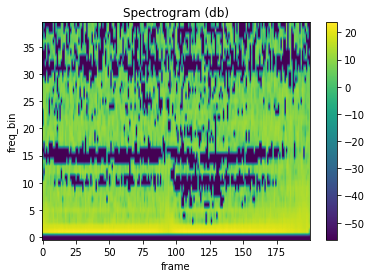

In [ ]:
mfcc_transform = torchaudio.transforms.MFCC(sample_rate=4000,)
mfcc = mfcc_transform(audio)
plot_spectrogram(mfcc[0])

In [ ]:
print(np.asarray(mfcc[0]).shape)
print(mfcc[0])

(40, 200)
tensor([[-4.5571e+02, -4.9566e+02, -4.6821e+02,  ..., -5.0769e+02,
         -5.0735e+02, -2.7982e+02],
        [ 9.2754e+01,  9.3988e+01,  1.2009e+02,  ...,  7.9376e+01,
          7.5787e+01,  2.2090e+00],
        [ 9.1645e+01,  6.5095e+01,  6.8747e+01,  ...,  5.9385e+01,
          5.6734e+01,  3.8334e+01],
        ...,
        [-6.5778e-01,  1.1431e+00, -2.6092e-02,  ..., -2.1906e-02,
          2.9274e+00, -1.0128e+00],
        [ 2.2409e+00, -3.2187e-01, -5.8667e+00,  ...,  4.3145e+00,
          2.6300e-01, -1.9613e+00],
        [-9.4914e-02,  3.3856e-01, -7.7925e+00,  ...,  3.4829e+00,
         -1.3614e-01, -1.2615e+00]])


In [ ]:
audio2 = librosa.feature.inverse.mfcc_to_audio(np.asarray(mfcc[0]))
# audio = torchaudio.transforms.Resample(orig_freq=16000, new_freq=16000)(audio)
ipd.Audio(data=audio2, rate=sr, autoplay=True)

In [ ]:
import soundfile as sf
sf.write('/content/prova.wav', audio2, 44000)

In [ ]:
tmp, sr2 = torchaudio.load("/content/prova.wav")
ipd.Audio(data=tmp, rate=sr)

In [ ]:
sr2

44000

### Band-pass filter


In [ ]:
!pip3 install torch==1.10.0+cu113 torchvision==0.11.1+cu113 torchaudio===0.10.0+cu113 -f https://download.pytorch.org/whl/cu113/torch_stable.html

Looking in links: https://download.pytorch.org/whl/cu113/torch_stable.html
     |██████████████▋                 | 834.1 MB 1.4 MB/s eta 0:11:46tcmalloc: large alloc 1147494400 bytes == 0x55afd1518000 @  0x7f3f1400a615 0x55af98d0b4cc 0x55af98deb47a 0x55af98d0e2ed 0x55af98dffe1d 0x55af98d81e99 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d81d00 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d7e737 0x55af98e00c66 0x55af98d7ddaf 0x55af98e00c66 0x55af98d7ddaf 0x55af98e00c66 0x55af98d7ddaf 0x55af98d10039 0x55af98d53409 0x55af98d0ec52 0x55af98d81c25 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d7e737 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d7d915 0x55af98d0fafa 0x55af98d7dc0d 0x55af98d7c9ee
     |██████████████████▌             | 1055.7 MB 1.6 MB/s eta 0:08:01tcmalloc: large alloc 1434370048 bytes == 0x55b015b6e000 @  0x7f3f1400a615 0x55af98d0b4cc 0x55af98deb47a 0x55af98d0e2ed 0x55af98dffe1d 0x55af98d81e99 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d81d00 0x55af98d7c9ee 0x55af98d0fbda 0x55af98d7e737 0x55af98e00c66 0x55af

In [ ]:
!pip install torchaudio
import torchaudio

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Tesi/dataset_rc.csv')
df.head()

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none


In [ ]:
!7z x /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip -o/content/


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Tesi/                                      1 file, 2090629544 bytes (1994 MiB)

Extracting archive: /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip
 59% 4096 Open              --
Path = /content/drive/MyDrive/Tesi/dataset_cicli_respiratori.zip
Type = zip
Physical Size = 2090629544

  0%      0% 20 - dataset_cicli_respiratori/160_1b2_Pl_mc_AKGC417L_1.wav                                                                  0% 41 - dataset_cicli_respiratori/163_2b2_Al_mc_AKGC417L_1.wav

#### hf_lung_v1


In [ ]:
!rm -r /content/test
!rm -r /content/train
!rm -r /content/test_bandPass
!rm -r /content/train_bandPass

In [ ]:
!mkdir /content/test_bandPass
!mkdir /content/train_bandPass
!unzip -x $'/content/drive/MyDrive/Tesi/test-HF_Lung_V1.zip' -d /content/
!unzip -x $'/content/drive/MyDrive/Tesi/train-HF_Lung_V1.zip' -d /content/

Output streaming troncato alle ultime 5000 righe.
  inflating: /content/train/trunc_2019-06-13-11-32-14-L4_5_label.txt  
  inflating: /content/train/steth_20190630_11_40_38_label.txt  
  inflating: /content/train/trunc_2019-05-16-15-53-58-L2_6_label.txt  
  inflating: /content/train/trunc_2019-06-30-11-43-25-L1_14.wav  
  inflating: /content/train/trunc_2019-06-13-11-32-14-L2_1_label.txt  
  inflating: /content/train/trunc_2019-05-07-16-04-05-L1_12_label.txt  
  inflating: /content/train/trunc_2019-05-07-15-00-52-L6_1.wav  
  inflating: /content/train/trunc_2019-07-17-10-07-09-L5_4.wav  
  inflating: /content/train/trunc_2019-07-17-11-08-44-L2_7_label.txt  
  inflating: /content/train/trunc_2019-07-28-11-08-24-L5_11.wav  
  inflating: /content/train/trunc_2019-07-28-11-41-44-L5_3.wav  
  inflating: /content/train/steth_20181022_09_37_03.wav  
  inflating: /content/train/steth_20190626_10_47_00.wav  
  inflating: /content/train/trunc_2019-05-31-15-38-07-L1_4.wav  
  inflating: /content/

In [ ]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

In [ ]:
# import threading
# from threading import *
import soundfile as sf
import os

def new_dataset_bandPass(path):
  # df_bandPass = pd.DataFrame(columns=['filename'])

  for filename in tqdm(os.listdir(path)):
    if filename.endswith(".wav"):

      audio, sr = librosa.load(path+'/'+filename)
      audio = librosa.resample(audio, sr, 4000)
      # Sample rate and desired cutoff frequencies (in Hz).
      fs = sr
      lowcut = 120.0
      highcut = 1800.0

      y = butter_bandpass_filter(audio, lowcut, highcut, 4000, order=7)
      # print(path+'_bandPass/'+filename)
      # break
      sf.write(path+'_bandPass/'+filename, y, 4000)
      # df_bandPass = df_bandPass.append({'filename':path, 'label': label}, ignore_index=True)
    # return df_bandPass

In [ ]:
# df_binary = pd.read_csv('/content/drive/MyDrive/Tesi/df_binary.csv')
new_dataset_bandPass("/content/test")
new_dataset_bandPass("/content/train")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  if __name__ == '__main__':


  0%|          | 0/3912 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  if __name__ == '__main__':


  0%|          | 0/15618 [00:00<?, ?it/s]

In [ ]:
!ls -a train_bandPass

In [ ]:
!zip -r drive/MyDrive/Tesi/train_bandPass4khz_hf-lung.zip train_bandPass/
!zip -r drive/MyDrive/Tesi/test_bandPass4khz_hf-lung.zip test_bandPass/

Output streaming troncato alle ultime 5000 righe.
  adding: train_bandPass/steth_20181219_08_39_16.wav (deflated 24%)
  adding: train_bandPass/trunc_2019-06-30-10-08-35-L2_4.wav (deflated 23%)
  adding: train_bandPass/trunc_2019-07-31-10-50-18-L5_4.wav (deflated 26%)
  adding: train_bandPass/steth_20190717_10_09_29.wav (deflated 26%)
  adding: train_bandPass/steth_20190516_16_27_08.wav (deflated 16%)
  adding: train_bandPass/steth_20190613_11_56_54.wav (deflated 21%)
  adding: train_bandPass/steth_20181110_17_29_54.wav (deflated 21%)
  adding: train_bandPass/steth_20190728_12_05_26.wav (deflated 20%)
  adding: train_bandPass/trunc_2019-05-07-16-04-05-L2_5.wav (deflated 18%)
  adding: train_bandPass/trunc_2019-05-07-15-32-30-L6_6.wav (deflated 28%)
  adding: train_bandPass/trunc_2019-05-07-16-03-02-L4_7.wav (deflated 21%)
  adding: train_bandPass/steth_20190123_08_38_42.wav (deflated 27%)
  adding: train_bandPass/trunc_2019-05-31-15-38-07-L6_10.wav (deflated 21%)
  adding: train_bandPas

In [ ]:
# train_bandPass.to_csv(r'/content/drive/MyDrive/Tesi/train_bandPass_hf-lung.csv', index=False)

#### Prove

In [ ]:
!unzip /content/drive/MyDrive/Tesi/dataset_bandPass2.zip

Output streaming troncato alle ultime 5000 righe.
  inflating: dataset_bandPass2/218_1b1_Lr_sc_Meditron_8_bandPass2.wav  
  inflating: dataset_bandPass2/156_8b3_Al_mc_AKGC417L_3_bandPass2.wav  
  inflating: dataset_bandPass2/110_1p1_Al_sc_Meditron_5_bandPass2.wav  
  inflating: dataset_bandPass2/176_2b3_Ll_mc_AKGC417L_6_bandPass2.wav  
  inflating: dataset_bandPass2/146_8p3_Pl_mc_AKGC417L_5_bandPass2.wav  
  inflating: dataset_bandPass2/132_2b1_Lr_mc_LittC2SE_2_bandPass2.wav  
  inflating: dataset_bandPass2/107_3p2_Tc_mc_AKGC417L_2_bandPass2.wav  
  inflating: dataset_bandPass2/226_1b1_Ll_sc_Meditron_0_bandPass2.wav  
  inflating: dataset_bandPass2/107_2b4_Tc_mc_AKGC417L_0_bandPass2.wav  
  inflating: dataset_bandPass2/207_2b2_Pl_mc_AKGC417L_2_bandPass2.wav  
  inflating: dataset_bandPass2/154_4b4_Pr_mc_AKGC417L_5_bandPass2.wav  
  inflating: dataset_bandPass2/193_1b2_Ll_mc_AKGC417L_6_bandPass2.wav  
  inflating: dataset_bandPass2/109_1b1_Lr_sc_Litt3200_7_bandPass2.wav  
  inflating: d

In [ ]:
# path = "/content/dataset_cicli_respiratori/" + df['filename'][300] + ".wav" #1658
audio, sr = librosa.load('dataset_bandPass2/181_1b3_Tc_mc_LittC2SE_3_bandPass2.wav')
ipd.Audio(data=audio, rate=sr, autoplay=False)

In [ ]:
sr

22050

In [ ]:
np.asarray(audio)

array([-3.0517578e-05, -3.0517578e-05, -3.0517578e-05, ...,
       -3.7536621e-03, -4.4555664e-03, -4.9438477e-03], dtype=float32)

In [ ]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y


# Sample rate and desired cutoff frequencies (in Hz).
fs = sr
lowcut = 120.0
highcut = 1800.0

y = butter_bandpass_filter(audio, lowcut, highcut, fs, order=7)

NameError: ignored

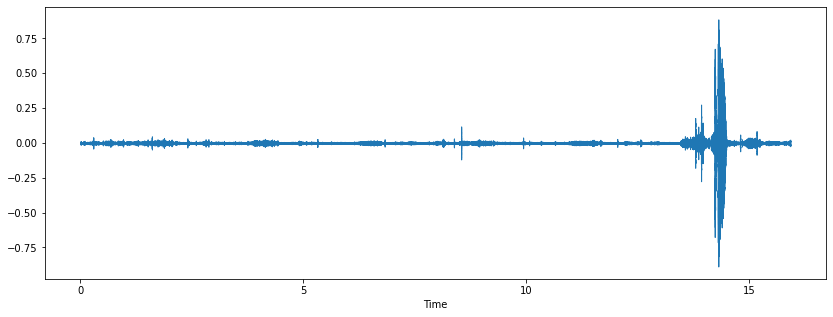

In [ ]:

# import plotly.graph_objects as go
# fig = go.Figure()
# fig.add_trace(go.Scatter(
#             y = audio,
#             line =  dict(shape =  'spline' ),
#             name = 'signal with noise'
#             ))
# fig.add_trace(go.Scatter(
#             y = y,
#             line =  dict(shape =  'spline' ),
#             name = 'filtered signal'
#             ))
# fig.show()
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y)

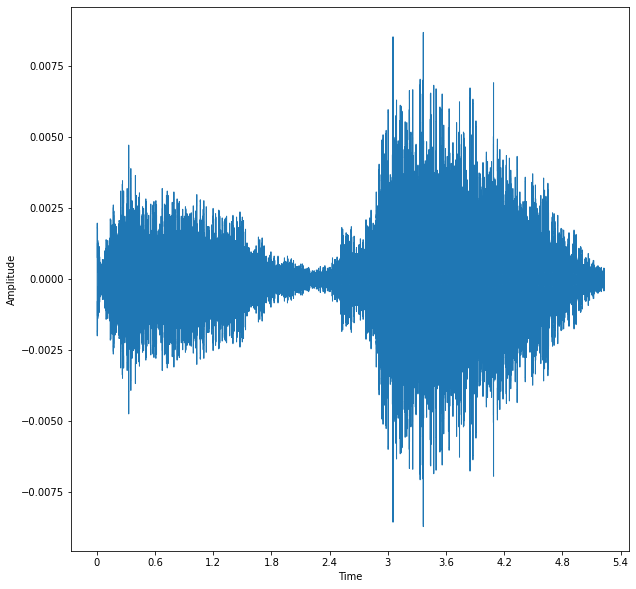

In [ ]:
# fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True)
# fig = plt.figure()
fig = plt.figure(figsize=(10, 10))
plt.ylabel('Amplitude')
# plt.xlabel('Mark-up')
librosa.display.waveshow(audio)
plt.savefig('ciclo.png')

In [ ]:
ipd.Audio(data=y, rate=sr, autoplay=True)

In [ ]:
ipd.Audio(data=audio, rate=sr, autoplay=True)

In [ ]:
df

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none
...,...,...
6893,226_1b1_Pl_sc_Meditron_5,crackle
6894,226_1b1_Pl_sc_Meditron_6,crackle
6895,226_1b1_Pl_sc_Meditron_7,none
6896,226_1b1_Pl_sc_Meditron_8,none


#### Creazione dataset

In [ ]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y



In [ ]:
# import threading
# from threading import *
import soundfile as sf

def new_dataset_bandPass(df_binary):
  df_bandPass = pd.DataFrame(columns=['filename', 'label'])
  for elem,label in tqdm(zip(df_binary['filename'], df_binary['label']), total=df_binary.shape[0]):
    path = elem.replace('.wav', '_bandPass3.wav')
    path = path.replace('dataset_cicli_respiratori', 'dataset_bandPass3')
    # if path in df_bandPass['filename'].unique():
    #   continue
    # elem2 = "/content/dataset_cicli_respiratori/"+elem+".wav"
    audio, sr = librosa.load(elem)

    # Sample rate and desired cutoff frequencies (in Hz).
    fs = sr
    lowcut = 100.0
    highcut = 500.0

    y = butter_bandpass_filter(audio, lowcut, highcut, fs, order=7)

    sf.write(path, y, sr)
    df_bandPass = df_bandPass.append({'filename':path, 'label': label}, ignore_index=True)
  return df_bandPass

In [ ]:
df_binary = pd.read_csv('/content/drive/MyDrive/Tesi/df_binary.csv')
df_bandPass = new_dataset_bandPass(df_binary)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


  0%|          | 0/6898 [00:00<?, ?it/s]

In [ ]:
!zip -r drive/MyDrive/Tesi/dataset_bandPass3.zip dataset_bandPass3/

Output streaming troncato alle ultime 5000 righe.
  adding: dataset_bandPass3/120_1b1_Pl_sc_Meditron_24_bandPass3.wav (deflated 99%)
  adding: dataset_bandPass3/130_2p5_Pl_mc_AKGC417L_5_bandPass3.wav (deflated 99%)
  adding: dataset_bandPass3/133_2p2_Al_mc_AKGC417L_4_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/170_1b4_Pr_mc_AKGC417L_0_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/203_2p3_Ar_mc_AKGC417L_4_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/130_3b4_Pr_mc_AKGC417L_0_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/132_2b2_Lr_mc_LittC2SE_0_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/170_2b2_Pl_mc_AKGC417L_1_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/143_1b1_Al_sc_Meditron_6_bandPass3.wav (deflated 99%)
  adding: dataset_bandPass3/215_1b2_Ar_sc_Meditron_2_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/166_1p1_Ar_sc_Meditron_6_bandPass3.wav (deflated 100%)
  adding: dataset_bandPass3/211_2p3_Tc_

In [ ]:
df_bandPass.to_csv(r'/content/drive/MyDrive/Tesi/dataset_bandPass3.csv', index=False)

### Nuovo dataset pathology-driven


In [ ]:
!7z x /content/drive/MyDrive/Tesi/ICBHI_final_database.zip -o/content/


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Tesi/                                      1 file, 1978998275 bytes (1888 MiB)

Extracting archive: /content/drive/MyDrive/Tesi/ICBHI_final_database.zip
--
Path = /content/drive/MyDrive/Tesi/ICBHI_final_database.zip
Type = zip
Physical Size = 1978998275

  0%      0% 18 - ICBHI_final_database/107_2b3_Ll_mc_AKGC417L.wav                                                           1% 26 - ICBHI_final_database/107_2b4_Ar_mc_AKGC417L.wav                                               

In [ ]:
#c'è un errore su un file del dataset che non è stato rinominato con lo strumento di registrazione giusto

!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.txt 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.txt
!mv 'ICBHI_final_database'/226_1b1_Pl_sc_LittC2SE.wav 'ICBHI_final_database'/226_1b1_Pl_sc_Meditron.wav

In [ ]:
df_diagnosis = pd.read_csv('/content/drive/MyDrive/Tesi/diagnosis.csv',sep=';', header=None, names=['patient', 'diagnosy'] )
df_diagnosis.iloc[87]

patient      188
diagnosy    URTI
Name: 87, dtype: object

In [ ]:
df_diagnosis.diagnosy.iloc[224-101]

'Healthy'

In [ ]:
tmp='234_sdasda_Da32_asdas'
tmp.split('_')[0]

'234'

In [ ]:
first_id_patient=101
df_pat = pd.DataFrame(columns=['filename', 'label'])

for filename in tqdm(os.listdir('/content/ICBHI_final_database/')):
    if filename.endswith(".wav"):
      id_patient = int(filename.split('_')[0])
      df_pat= df_pat.append({'filename': '/content/ICBHI_final_database/'+filename, 'label': df_diagnosis.diagnosy.iloc[id_patient - first_id_patient]}, ignore_index=True)

df_pat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


  0%|          | 0/1843 [00:00<?, ?it/s]

,filename,label
0,/content/ICBHI_final_database/172_1b5_Tc_mc_AK...,COPD
1,/content/ICBHI_final_database/162_2b2_Al_mc_AK...,COPD
2,/content/ICBHI_final_database/139_1b1_Ar_sc_Li...,COPD
3,/content/ICBHI_final_database/176_1b3_Al_mc_AK...,COPD
4,/content/ICBHI_final_database/151_3p3_Ll_mc_AK...,COPD
...,...,...
915,/content/ICBHI_final_database/114_1b4_Lr_mc_AK...,COPD
916,/content/ICBHI_final_database/188_1b1_Ar_sc_Me...,URTI
917,/content/ICBHI_final_database/223_1b1_Pr_sc_Me...,COPD
918,/content/ICBHI_final_database/221_2b2_Al_mc_Li...,COPD


In [ ]:
df_pat.to_csv('/content/drive/MyDrive/Tesi/df_pat.csv', index=False)

In [ ]:
df_pat.filename.iloc[0]

'/content/ICBHI_final_database/172_1b5_Tc_mc_AKGC417L.wav'

#### prove

In [ ]:
!pip install torchaudio
import torchaudio

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Tesi/df_pat.csv')
df.head()

,filename,label
0,/content/ICBHI_final_database/172_1b5_Tc_mc_AK...,COPD
1,/content/ICBHI_final_database/162_2b2_Al_mc_AK...,COPD
2,/content/ICBHI_final_database/139_1b1_Ar_sc_Li...,COPD
3,/content/ICBHI_final_database/176_1b3_Al_mc_AK...,COPD
4,/content/ICBHI_final_database/151_3p3_Ll_mc_AK...,COPD


In [ ]:
# path = "/content/dataset_cicli_respiratori/" + df['filename'][300] + ".wav" #1658
audio, sr = librosa.load(df.filename.iloc[39])
ipd.Audio(data=audio, rate=sr, autoplay=True)

In [ ]:
sr

22050

In [ ]:
np.asarray(audio)

array([0.        , 0.        , 0.        , ..., 0.00359949, 0.00292374,
       0.00201758], dtype=float32)

In [ ]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y


# Sample rate and desired cutoff frequencies (in Hz).
fs = sr
lowcut = 120.0
highcut = 1800.0

y = butter_bandpass_filter(audio, lowcut, highcut, fs, order=7)

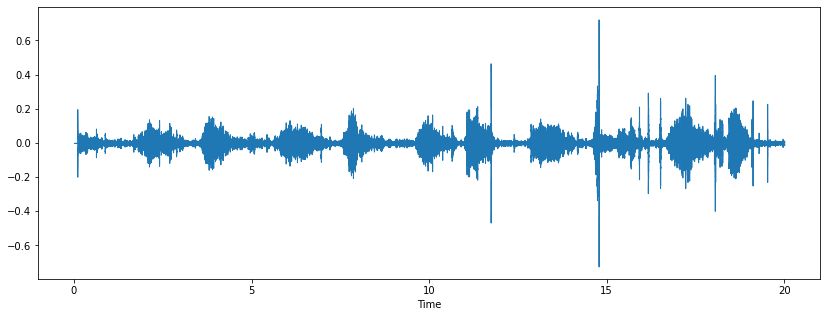

In [ ]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y)

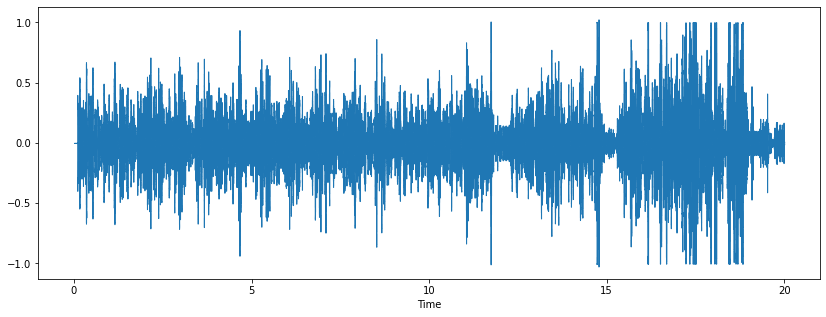

In [ ]:
# fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio)

In [ ]:
ipd.Audio(data=y, rate=sr, autoplay=True)

In [ ]:
ipd.Audio(data=audio, rate=sr, autoplay=True)

#### creazione dataset con filtro passa-banda

In [ ]:
from scipy.signal import butter, lfilter
from scipy.signal import freqz


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y



In [ ]:
# import threading
# from threading import *
import soundfile as sf

def new_dataset_bandPass(df_pat):
  df_pat_bandPass2 = pd.DataFrame(columns=['filename', 'label'])
  for elem,label in tqdm(zip(df_pat['filename'], df_pat['label']), total=df_pat.shape[0]):
    path = elem.replace('.wav', '_bandPass2.wav')
    path = path.replace('ICBHI_final_database', 'dataset_pat_bandPass2')
    # if path in df_bandPass['filename'].unique():
    #   continue
    # elem2 = "/content/dataset_cicli_respiratori/"+elem+".wav"
    audio, sr = librosa.load(elem)

    # Sample rate and desired cutoff frequencies (in Hz).
    fs = sr
    lowcut = 120.0
    highcut = 1800.0

    y = butter_bandpass_filter(audio, lowcut, highcut, fs, order=7)

    sf.write(path, y, sr)
    df_pat_bandPass2 = df_pat_bandPass2.append({'filename':path, 'label': label}, ignore_index=True)
  return df_pat_bandPass2

In [ ]:
# df_pat = pd.read_csv('/content/drive/MyDrive/Tesi/df_pat.csv')
df_pat_bandPass = new_dataset_bandPass(df_pat)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


  0%|          | 0/920 [00:00<?, ?it/s]

In [ ]:
!zip -r drive/MyDrive/Tesi/dataset_pat_bandPass2.zip dataset_pat_bandPass2/

  adding: dataset_pat_bandPass2/ (stored 0%)
  adding: dataset_pat_bandPass2/138_1p4_Pr_mc_AKGC417L_bandPass2.wav (deflated 16%)
  adding: dataset_pat_bandPass2/192_2b2_Ar_mc_LittC2SE_bandPass2.wav (deflated 38%)
  adding: dataset_pat_bandPass2/192_2b2_Al_mc_LittC2SE_bandPass2.wav (deflated 49%)
  adding: dataset_pat_bandPass2/132_2b2_Lr_mc_LittC2SE_bandPass2.wav (deflated 65%)
  adding: dataset_pat_bandPass2/221_2b1_Ar_mc_LittC2SE_bandPass2.wav (deflated 36%)
  adding: dataset_pat_bandPass2/130_3p4_Pr_mc_AKGC417L_bandPass2.wav (deflated 22%)
  adding: dataset_pat_bandPass2/177_2b4_Lr_mc_AKGC417L_bandPass2.wav (deflated 24%)
  adding: dataset_pat_bandPass2/176_2b3_Ll_mc_AKGC417L_bandPass2.wav (deflated 27%)
  adding: dataset_pat_bandPass2/147_1b3_Tc_mc_AKGC417L_bandPass2.wav (deflated 12%)
  adding: dataset_pat_bandPass2/200_2p3_Tc_mc_AKGC417L_bandPass2.wav (deflated 23%)
  adding: dataset_pat_bandPass2/186_3b3_Al_mc_AKGC417L_bandPass2.wav (deflated 28%)
  adding: dataset_pat_bandPass2

In [ ]:
df_pat_bandPass.to_csv(r'/content/drive/MyDrive/Tesi/dataset_pat_bandPass2.csv', index=False)

### Dataset pathology con cicli respiratori

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Tesi/dataset_rc.csv')
df.head()

,filename,label
0,101_1b1_Al_sc_Meditron_0,none
1,101_1b1_Al_sc_Meditron_1,none
2,101_1b1_Al_sc_Meditron_10,none
3,101_1b1_Al_sc_Meditron_11,none
4,101_1b1_Al_sc_Meditron_2,none


In [ ]:
df_diagnosis = pd.read_csv('/content/drive/MyDrive/Tesi/diagnosis.csv',sep=';', header=None, names=['patient', 'diagnosy'] )

In [ ]:
df_pat_rc = pd.DataFrame(columns=['filename', 'label'])
first_id_patient=101
for elem,label in zip(df.filename, df.label):
  if label=='none':
    df_pat_rc = df_pat_rc.append({'filename':'/content/dataset_bandPass2/'+elem+'_bandPass2.wav', 'label':'Healthy'},ignore_index=True)
  else:
    id_patient = int(elem.split('_')[0])
    df_pat_rc= df_pat_rc.append({'filename': '/content/dataset_bandPass2/'+elem+'_bandPass2.wav', 'label': df_diagnosis.diagnosy.iloc[id_patient - first_id_patient]}, ignore_index=True)

df_pat_rc.head()


,filename,label
0,/content/dataset_bandPass2/101_1b1_Al_sc_Medit...,URTI
1,/content/dataset_bandPass2/101_1b1_Al_sc_Medit...,URTI
2,/content/dataset_bandPass2/101_1b1_Al_sc_Medit...,URTI
3,/content/dataset_bandPass2/101_1b1_Al_sc_Medit...,URTI
4,/content/dataset_bandPass2/101_1b1_Al_sc_Medit...,URTI


In [ ]:
df_pat_rc.groupby('label').count()

,filename
label,
Asthma,6
Bronchiectasis,104
Bronchiolitis,160
COPD,5746
Healthy,322
LRTI,32
Pneumonia,285
URTI,243


In [ ]:
df_pat_rc.to_csv('/content/drive/MyDrive/Tesi/dataset_pat_rc.csv', index=False)

In [ ]:
df.filename

0        101_1b1_Al_sc_Meditron_0
1        101_1b1_Al_sc_Meditron_1
2       101_1b1_Al_sc_Meditron_10
3       101_1b1_Al_sc_Meditron_11
4        101_1b1_Al_sc_Meditron_2
                  ...            
6893     226_1b1_Pl_sc_Meditron_5
6894     226_1b1_Pl_sc_Meditron_6
6895     226_1b1_Pl_sc_Meditron_7
6896     226_1b1_Pl_sc_Meditron_8
6897     226_1b1_Pl_sc_Meditron_9
Name: filename, Length: 6898, dtype: object

### creazione dataset train e test rc

In [ ]:
train_test_split = pd.read_csv('/content/drive/MyDrive/Tesi/train-test_split.txt', sep="\t", header=None)
train_test_split.columns = ["filename", "dest"]
train = train_test_split[train_test_split.dest=='train']
test = train_test_split[train_test_split.dest=='test']

In [ ]:
print(f"train shape: {train.shape}")
print(f"Test shape: {test.shape}")

train shape: (539, 2)
Test shape: (381, 2)


In [ ]:
train_rc = pd.DataFrame(columns=['filename', 'label'])
test_rc = pd.DataFrame(columns=['filename', 'label'])
for elem, dest in tqdm(zip(train_test_split.filename, train_test_split.dest),total=train_test_split.shape[0]):
  for elem2, label in zip(df_rc.filename, df_rc.label):
    if elem in elem2:
      if dest=='train':
        train_rc = train_rc.append({'filename':elem2, 'label':label}, ignore_index=True)
      elif dest=='test':
        test_rc = test_rc.append({'filename':elem2, 'label':label},ignore_index=True)

print(f"train shape: {train_rc.shape}")
print(f"Test shape: {test_rc.shape}")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


  0%|          | 0/920 [00:00<?, ?it/s]

train shape: (4142, 2)
Test shape: (2756, 2)


In [ ]:
train_rc

,filename,label
0,103_2b2_Ar_mc_LittC2SE_0,wheeze
1,103_2b2_Ar_mc_LittC2SE_1,none
2,103_2b2_Ar_mc_LittC2SE_2,wheeze
3,103_2b2_Ar_mc_LittC2SE_3,wheeze
4,103_2b2_Ar_mc_LittC2SE_4,wheeze
...,...,...
4137,226_1b1_Pl_sc_Meditron_5,crackle
4138,226_1b1_Pl_sc_Meditron_6,crackle
4139,226_1b1_Pl_sc_Meditron_7,none
4140,226_1b1_Pl_sc_Meditron_8,none


In [ ]:
train_rc.to_csv('/content/drive/MyDrive/Tesi/train_rc.csv', index=False)
test_rc.to_csv('/content/drive/MyDrive/Tesi/test_rc.csv', index=False)

In [ ]:
'101_1b1_Al_sc_Meditron' in df_rc.filename.iloc[2]

True

#### Final dataset 80-20

In [ ]:
df_rc = pd.read_csv("/content/drive/MyDrive/Tesi/dataset_rc.csv")
train_rc, test_rc = train_test_split(df_rc, test_size=0.2, random_state=33)#, stratify=df["label"])
# train_rc = train_rc.reset_index(drop=True)
# test_rc = test_rc.reset_index(drop=True)
print(train_rc.shape)
print(test_rc.shape)

(5518, 2)
(1380, 2)


In [ ]:
train_rc

,filename,label
5305,194_1b1_Pr_sc_Meditron_7,none
558,113_1b1_Ar_sc_Litt3200_2,none
6254,211_1p2_Pr_mc_AKGC417L_11,none
785,120_1b1_Lr_sc_Meditron_26,none
5798,203_1p4_Pr_mc_AKGC417L_0,none
...,...,...
3273,158_1p4_Tc_mc_AKGC417L_8,none
2706,154_1b3_Ll_mc_AKGC417L_0,crackle
578,113_1b1_Lr_sc_Litt3200_3,none
5848,204_2b5_Al_mc_AKGC417L_2,wheeze


In [ ]:
train_rc.to_csv('/content/drive/MyDrive/Tesi/train_rc.csv' , index=False)
test_rc.to_csv('/content/drive/MyDrive/Tesi/test_rc.csv', index=False)

In [ ]:
tmp=pd.read_csv('/content/drive/MyDrive/Tesi/test_rc.csv')
tmp

,filename\tlabel
0,157_1b1_Pr_sc_Meditron_2\tcrackle
1,130_2b2_Al_mc_AKGC417L_5\tcrackle
2,210_1b1_Ar_sc_Meditron_10\tnone
3,163_8b3_Ll_mc_AKGC417L_3\tnone
4,178_1b6_Pl_mc_AKGC417L_6\tnone
...,...
1375,147_1b2_Tc_mc_AKGC417L_6\tnone
1376,192_2b2_Al_mc_LittC2SE_3\tboth
1377,130_1p2_Pl_mc_AKGC417L_3\tcrackle
1378,200_2p3_Pr_mc_AKGC417L_2\tnone


#### Final dataset pathology 80-20

In [ ]:
df_pathology = pd.read_csv("/content/drive/MyDrive/Tesi/dataset_pat_bandPass2.csv")

In [ ]:
df_binary = df_pathology.copy()
df_binary['label'] = (df_binary['label'] =='Healthy')*1
df_binary

,filename,label
0,/content/dataset_pat_bandPass2/172_1b5_Tc_mc_A...,0
1,/content/dataset_pat_bandPass2/162_2b2_Al_mc_A...,0
2,/content/dataset_pat_bandPass2/139_1b1_Ar_sc_L...,0
3,/content/dataset_pat_bandPass2/176_1b3_Al_mc_A...,0
4,/content/dataset_pat_bandPass2/151_3p3_Ll_mc_A...,0
...,...,...
915,/content/dataset_pat_bandPass2/114_1b4_Lr_mc_A...,0
916,/content/dataset_pat_bandPass2/188_1b1_Ar_sc_M...,0
917,/content/dataset_pat_bandPass2/223_1b1_Pr_sc_M...,0
918,/content/dataset_pat_bandPass2/221_2b2_Al_mc_L...,0


In [ ]:
train_binary_pathology, test_binary_pathology = train_test_split(df_binary, test_size=0.2, random_state=33)
print(train_binary_pathology.shape)
print(test_binary_pathology.shape)

(736, 2)
(184, 2)


In [ ]:
train_binary_pathology.head()

,filename,label
520,/content/dataset_pat_bandPass2/205_1b3_Ar_mc_A...,0
664,/content/dataset_pat_bandPass2/151_3p2_Al_mc_A...,0
846,/content/dataset_pat_bandPass2/226_1b1_Ll_sc_M...,0
366,/content/dataset_pat_bandPass2/130_3p2_Pl_mc_A...,0
162,/content/dataset_pat_bandPass2/135_2b2_Al_mc_L...,0


In [ ]:
train_binary_pathology.groupby('label').count()

,filename
label,
0,711
1,25


In [ ]:
test_binary_pathology.groupby('label').count()

,filename
label,
0,174
1,10


In [ ]:
train_binary_pathology.to_csv('/content/drive/MyDrive/Tesi/train_binary_pathology.csv' , index=False)
test_binary_pathology.to_csv('/content/drive/MyDrive/Tesi/test_binary_pathology.csv', index=False)

-----------------

In [ ]:
df_multiclass = df_pathology.copy()
# df_binary['label'] = (df_rc['label']!= ('crackle' or 'wheeze' or 'both'))*1
#0:HEALTHY, 1:CHRONIC, 2:NON-CHRONIC
df_multiclass.loc[df_multiclass.label == "Healthy", "label"] = 0

df_multiclass.loc[df_multiclass.label == "COPD", "label"] = 1
df_multiclass.loc[df_multiclass.label == "Bronchiectasis", "label"] = 1
df_multiclass.loc[df_multiclass.label == "Asthma", "label"] = 1

df_multiclass.loc[df_multiclass.label == "LRTI", "label"] = 2
df_multiclass.loc[df_multiclass.label == "URTI", "label"] = 2
df_multiclass.loc[df_multiclass.label == "Pneumonia", "label"] = 2
df_multiclass.loc[df_multiclass.label == "Bronchiolitis", "label"] = 2
df_multiclass

,filename,label
0,/content/dataset_pat_bandPass2/172_1b5_Tc_mc_A...,1
1,/content/dataset_pat_bandPass2/162_2b2_Al_mc_A...,1
2,/content/dataset_pat_bandPass2/139_1b1_Ar_sc_L...,1
3,/content/dataset_pat_bandPass2/176_1b3_Al_mc_A...,1
4,/content/dataset_pat_bandPass2/151_3p3_Ll_mc_A...,1
...,...,...
915,/content/dataset_pat_bandPass2/114_1b4_Lr_mc_A...,1
916,/content/dataset_pat_bandPass2/188_1b1_Ar_sc_M...,2
917,/content/dataset_pat_bandPass2/223_1b1_Pr_sc_M...,1
918,/content/dataset_pat_bandPass2/221_2b2_Al_mc_L...,1


In [ ]:
train_multiclass_pathology, test_multiclass_pathology = train_test_split(df_multiclass, test_size=0.2, random_state=33)#, stratify=df["label"])
# train_rc = train_rc.reset_index(drop=True)
# test_rc = test_rc.reset_index(drop=True)
print(train_multiclass_pathology.shape)
print(test_multiclass_pathology.shape)

(736, 2)
(184, 2)


In [ ]:
train_multiclass_pathology.head()

,filename,label
520,/content/dataset_pat_bandPass2/205_1b3_Ar_mc_A...,1
664,/content/dataset_pat_bandPass2/151_3p2_Al_mc_A...,1
846,/content/dataset_pat_bandPass2/226_1b1_Ll_sc_M...,2
366,/content/dataset_pat_bandPass2/130_3p2_Pl_mc_A...,1
162,/content/dataset_pat_bandPass2/135_2b2_Al_mc_L...,2


In [ ]:
train_multiclass_pathology.groupby('label').count()

,filename
label,
0,25
1,648
2,63


In [ ]:
test_multiclass_pathology.groupby('label').count()

,filename
label,
0,10
1,162
2,12


In [ ]:
train_multiclass_pathology.to_csv('/content/drive/MyDrive/Tesi/train_multiclass_pathology.csv' , index=False)
test_multiclass_pathology.to_csv('/content/drive/MyDrive/Tesi/test_multiclass_pathology.csv', index=False)

In [ ]:
tmp=pd.read_csv('/content/drive/MyDrive/Tesi/test_rc.csv')
tmp

,filename\tlabel
0,157_1b1_Pr_sc_Meditron_2\tcrackle
1,130_2b2_Al_mc_AKGC417L_5\tcrackle
2,210_1b1_Ar_sc_Meditron_10\tnone
3,163_8b3_Ll_mc_AKGC417L_3\tnone
4,178_1b6_Pl_mc_AKGC417L_6\tnone
...,...
1375,147_1b2_Tc_mc_AKGC417L_6\tnone
1376,192_2b2_Al_mc_LittC2SE_3\tboth
1377,130_1p2_Pl_mc_AKGC417L_3\tcrackle
1378,200_2p3_Pr_mc_AKGC417L_2\tnone
